# A closer look at Confident Pause Sites

We inspect the pause sites coming from our diffrential pause site a analysis.



In [1]:
import ribopy
import numpy as np
import pandas as pd
import math

import scipy
import scipy.stats as stats
import matplotlib
import h5py

from collections import OrderedDict
import random
from multiprocessing import Pool
from functools import partial
import pickle
from collections import OrderedDict

from ribopy.core.get_gadgets import get_region_boundaries
from IPython.display import display_html

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [20, 6]

FIGURE_RESOLUTION = 600

In [3]:
# Import the manuscript 
import sys

sys.path.append('.')
from manuscript_colors import *
from fasta import FastaFile

In [4]:
ribo_path = "../manuscript.ribo"

def rename(x):
    return x.split("|")[4]

myribo = ribopy.Ribo(ribo_path, alias=rename)

In [5]:
myribo.print_info()

Ribo File Info:
---------------
Ribo File Version : 1.0
RiboPy Version    : 0.0.0
Creation Time     : 2020-09-03 10:26:28
Reference         : appris-v1
Min Read Length   : 15
Max Read Length   : 40
Metagene Radius   : 50
Left Span         : 35
Right Span        : 10

Experiments:
------------ 
Name                         Reads  Coverage  RNA-Seq  Metadata
20200717-NSP1-HEK-1-setB  12503413         *        *          
20200717-NSP1-HEK-2-setB  10390514         *        *          
20200717-NSP1-HEK-3-setB  16772718         *        *          
20200717-NSP2-HEK-1-setB  17989686         *        *          
20200717-NSP2-HEK-2-setB  16564558         *        *          
20200717-NSP2-HEK-3-setB  13487211         *        *          
20200717-WT-HEK-1-setB     8527167         *        *          
20200717-WT-HEK-2-setB    17504702         *        *          
20200717-WT-HEK-3-setB    11440519         *        *          


In [6]:
NSP1_experiments = ["20200717-NSP1-HEK-1-setB",
                    "20200717-NSP1-HEK-2-setB",
                    "20200717-NSP1-HEK-3-setB"]

NSP2_experiments = ["20200717-NSP2-HEK-1-setB",
                    "20200717-NSP2-HEK-2-setB",
                    "20200717-NSP2-HEK-3-setB"]

WT_experiments = ["20200717-WT-HEK-1-setB",
                  "20200717-WT-HEK-2-setB",
                  "20200717-WT-HEK-3-setB"]

NSP_experiments = NSP1_experiments + NSP2_experiments

all_experiments = NSP1_experiments + NSP2_experiments + WT_experiments

In [7]:
def get_coverage(ribo, 
                 experiment,
                 range_lower = 0,
                 range_upper = 0,
                 alias       = False,
                 multiplier  = 1):
    """
    NOTETHAT THIS FUNCTION RETURNS A TUPLE!!!
    
    coverage_dict: This is the output of the function "get_coverage"
    of the ribo object.
    
    Returns a pair: (dataframe, coverage_dict)
    
    The coverage dictionary has the nucleotide coveraage of all the 
    transcripts
    
    In the dataframe, the last column 
    has the coverage density of a given transcript.
    The normalized covarage is defined by
       (#total_reads / #transcript_length) * 1000000
    """
    
    coverage_dict = ribo.get_coverage(experiment  = experiment,
                                      range_lower = range_lower, 
                                      range_upper = range_upper,
                                      alias       = alias)
    
    region_boundaries = get_region_boundaries(ribo._handle)
    
    transcript_names     = coverage_dict.keys()
    transcript_coverages = coverage_dict.values()
    transcript_total     = tuple( map( np.sum, transcript_coverages ) )
    transcript_lengths   = tuple( map(len, transcript_coverages) )
    normalized_coverage  = np.divide(transcript_total , transcript_lengths) * multiplier
    start_sites          = tuple( map( lambda x: x[1][0], region_boundaries ) )
    stop_sites           = tuple( map( lambda x: x[1][1], region_boundaries ) )
    
    # We also add normalized cds coverage
    cds_data = zip( start_sites, stop_sites, transcript_coverages )
    norm_cds = tuple( map( lambda x:  
                              (np.sum( x[2][x[0]:x[1]] ) / (x[1] - x[0]) )* multiplier,
                      cds_data) )
    
    result = pd.DataFrame(data = { "total"     :  transcript_total, 
                                   "length"    :  transcript_lengths,
                                   "cds_start" :  start_sites,
                                   "cds_stop"  :  stop_sites,
                                   "norm_cds"  :  norm_cds,
                                   "norm_cov"  :  normalized_coverage}, 
                          index = transcript_names) 
    
    return( (result, coverage_dict))


# Definitions
coverage_min_length = 28
coverage_max_length = 35
this_alias          = rename

# experiment -> (coverage_df, nucleotide coverage)
# where nucleodite coverage is a dictionary of the form
#       transcript -> coverage vector
coverages = { e: get_coverage(
                     ribo        = myribo, 
                     experiment  = e,
                     range_lower = coverage_min_length,
                     range_upper = coverage_max_length,
                     alias       = rename)\

             for e in myribo.experiments}

In [8]:
transcriptome_fasta = "/data/projects/ITP/references/transcriptome/human/v1/riboflow_annot_and_ref/appris_human_v1_selected.fa.gz"
pre_gene_sequences  = FastaFile(transcriptome_fasta)

gene_sequences = dict()

for s in pre_gene_sequences:
    gene = rename(s.header)
    gene_sequences[gene] = s.sequence


In [9]:
tuple(gene_sequences.keys())[:5]

('OR4F5-201', 'OR4F29-201', 'OR4F16-201', 'SAMD11-202', 'NOC2L-201')

In [10]:
def adjust_position(position, gene, coverages):
    experiment = tuple(coverages.keys())[0]
    position   = int(position)
    cds_start  = coverages[experiment][0].loc[gene, "cds_start"]
    return cds_start + position

#EIF4B-201_1818
assert adjust_position(position = 1818, gene = "EIF4B-201", coverages = coverages) == 2144

In [11]:
def get_sequence(gene, sequence_dict, position, left = 10, right = 44, flank = 4):
    ribosome_size   = 28
    ribosome_start  = position + 1 + flank
    ribosome_end    = ribosome_start + ribosome_size
    
    entire_sequence = sequence_dict[gene]
    
    left_sequence     =  entire_sequence[position - left : position]
    pos_sequence      =  entire_sequence[position : position + 1]
    left_flank        =  entire_sequence[position + 1: ribosome_start]
    ribosome_sequence =  entire_sequence[ribosome_start : ribosome_end ]
    right_sequence    =  entire_sequence[ribosome_end : ribosome_end +  (right - ribosome_size) ]
    
    out_sequence = "{left}<b style=\"color:blue\">{pos}</b>{left_flank}<b style=\"color:red\">{ribo_seq}</b>{right}".\
       format(left       = left_sequence, 
              pos        = pos_sequence, 
              left_flank = left_flank, 
              ribo_seq   = ribosome_sequence,
              right      = right_sequence  )
    
    display_html(out_sequence, raw = True)
    
get_sequence( "EIF4B-201", gene_sequences, 1818 )   

TCTCAGAGCT C AGAC ACAGAGCAGCAGTCCCCTACAAGTGGTG GGGGAAAAGTAGCTCC

In [12]:
depth_dict = { e: myribo.info["experiments"][e]["Reads"] for e in myribo.experiments}

In [13]:
def plot_multiple_coverage(
                  coverages,
                  experiments,
                  gene_name, 
                  pause_site,
                  depth_dict  = None,
                  normalize   = False,
                  legend      = False,
):
    """
    If you want to get the results normalized,
    provide a dictionary of experiment sizes
       experiment_name -> size
    """
    
    coverage_dict = coverages
    #experiments   = ['20200717-NSP1-HEK-1-setB', '20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB', '20200717-WT-HEK-1-setB']          
    #gene_name     = "EEF1A1-202" 
    norm_factors  = depth_dict
    bin_size       = 1
    title          = ""
    
    ymax   = 0
    #colors = ["blue", "red", "green", "orange", "black", "yellow", "brown", "pink", "cyan"]
    #if len(experiments) > len(colors):
    #    print("Maximum {} exepriments are allowed.".format( len(colors) ) )
    
    cds_start = coverage_dict[experiments[0]][0].loc[gene_name, "cds_start"]
    cds_stop  = coverage_dict[experiments[0]][0].loc[gene_name, "cds_stop"]
    x_range   = tuple(range(cds_start, cds_stop)) 
    
    plot_pause_sites = [pause_site]
    
    
    for i, e in enumerate(experiments):
        e_vector = coverage_dict[e][1][gene_name][cds_start:cds_stop]
        
        if normalize:
            e_vector = np.divide(e_vector, norm_factors[e])
            
        this_color = EXPERIMENT_COLORS[e]
        #ax.plot(e_vector, alpha = 0.2, color = colors[i])
        plt.plot(x_range, e_vector, alpha = 0.3 , color = this_color)
        ymax = max(ymax, max(e_vector))
        

    
    ymin = -1 * 0.05 * ymax 
    #plt.set_ylim([ymin, ymax])
    #plt.set_xlim([0, len(e_vector)])
    
    edge = 0.001 * (cds_stop - cds_start)
    
    for site in plot_pause_sites: 
        plt.fill_between(x     = (site - edge , site + edge), 
                         y1    = ymin, y2 = 0, 
                         color = "#e31a1d", alpha = 0.3)
    

    plt.title(title + " " + gene_name)
    if legend: 
        plt.legend( tuple(map( lambda x: x[9:-5],experiments)), loc='upper right')

In [14]:
def plot_pause_site(
                  coverages,
                  experiments, 
                  pause_site,
                  gene_name,
                  radius      = 10, 
                  depth_dict  = None,
                  normalize   = False,
                  legend      = False,
):
    """
    If you want to get the results normalized,
    provide a dictionary of experiment sizes
       experiment_name -> size
    """
    
    coverage_dict = coverages
    #experiments   = ['20200717-NSP1-HEK-1-setB', '20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB', '20200717-WT-HEK-1-setB']          
    #gene_name     = "EEF1A1-202" 
    norm_factors  = depth_dict
    bin_size       = 1
    title          = ""
    

    #colors = ["blue", "red", "green", "orange", "black", "yellow", "brown", "pink", "cyan"]
    #if len(experiments) > len(colors):
    #    print("Maximum {} exepriments are allowed.".format( len(colors) ) )
    

    x_range   = tuple(range(pause_site - radius, pause_site + radius)) 

    
    
    for i, e in enumerate(experiments):
        e_vector = coverage_dict[e][1][gene_name][pause_site - radius: pause_site + radius]
        
        if normalize:
            e_vector = np.divide(e_vector, norm_factors[e])
            
        this_color = EXPERIMENT_COLORS[e]
        #ax.plot(e_vector, alpha = 0.2, color = colors[i])
        plt.plot(x_range, e_vector, alpha = 0.3 , color = this_color)


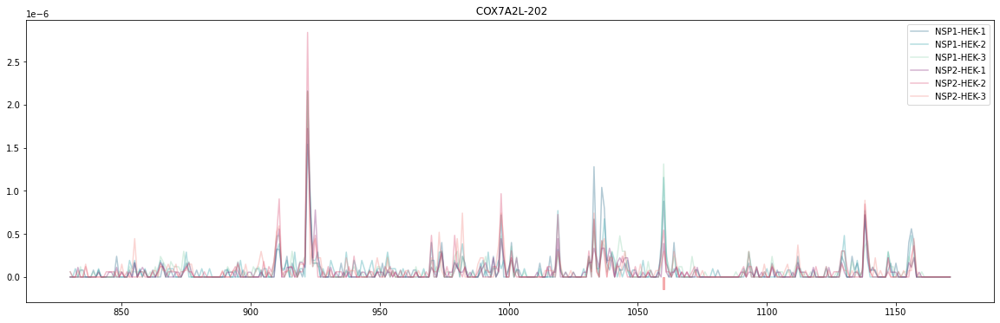

In [15]:
this_pause_site = adjust_position(position = 230, gene = "COX7A2L-202", coverages = coverages)

plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = NSP_experiments,
                  gene_name   = "COX7A2L-202" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True
)

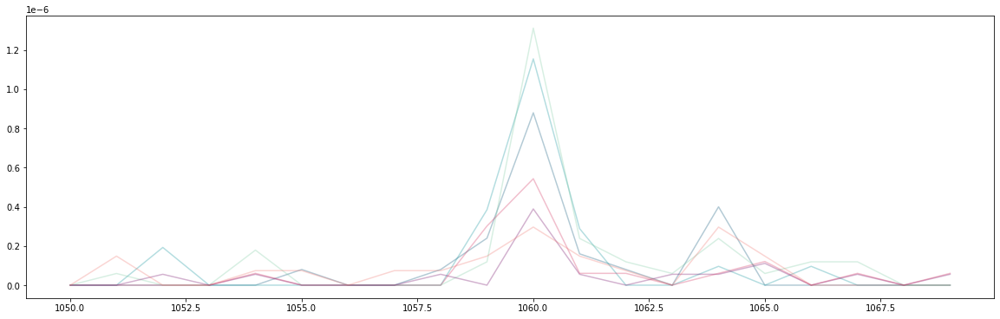

In [16]:
this_pause_site = adjust_position(position = 230, gene = "COX7A2L-202", coverages = coverages)


plot_pause_site(\
                  coverages  = coverages,
                  experiments = NSP_experiments, 
                  pause_site = this_pause_site,
                  gene_name = "COX7A2L-202",
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)

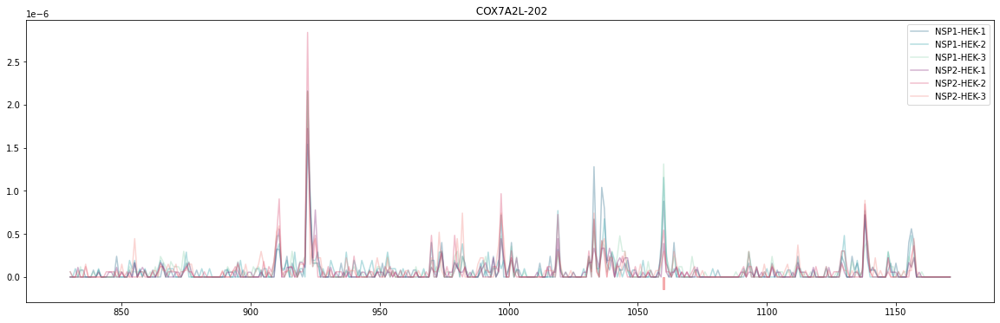

In [17]:
plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = NSP_experiments,
                  gene_name   = "COX7A2L-202" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True
)

## Level 1 Pause Sites


Recall that these pause sites are detected as significantly different. Yet their gene is not. Se we are very confident about these pause sites.

In [19]:
with open("level_1_diff_pause_sites.pick", "rb") as pickle_in:
        level_1_sites = pickle.load(pickle_in)

COX7A2L-202_230 logFC = 1.5832110166528324

CCGTCTACCT G AAAC GAGGCCTGCCTGACCAAATGCTTTACCG GACCACCATGGCGCTG

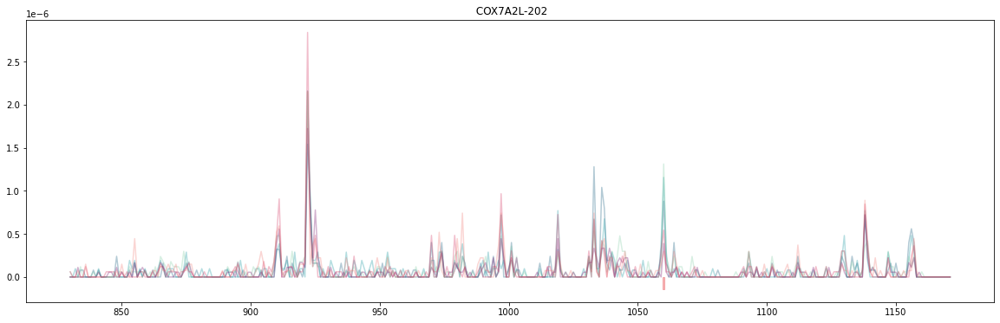

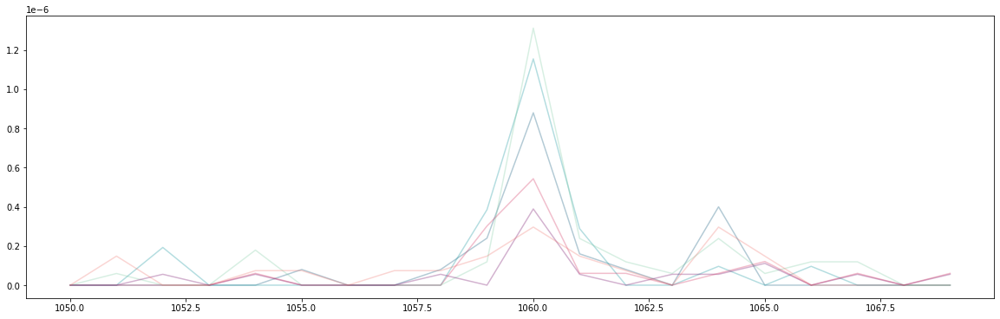

SFT2D2-201_395 logFC = 1.4142090360673105

GCATTTTGCA G TCTT TGGCATTGACGTGGTACAGCCTTTCCTT CATACCATTTGCAAGG

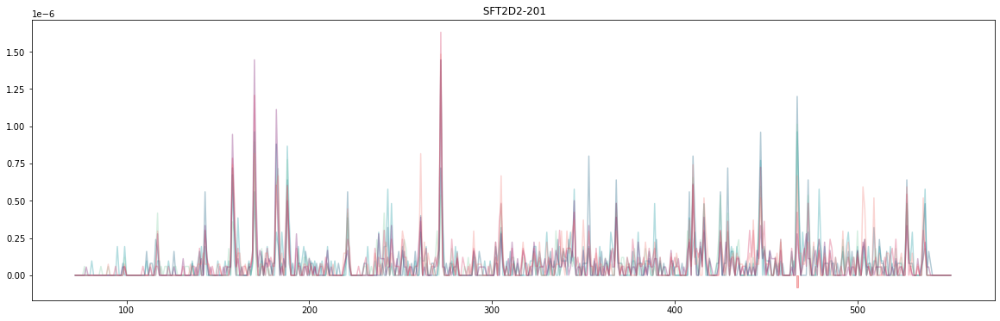

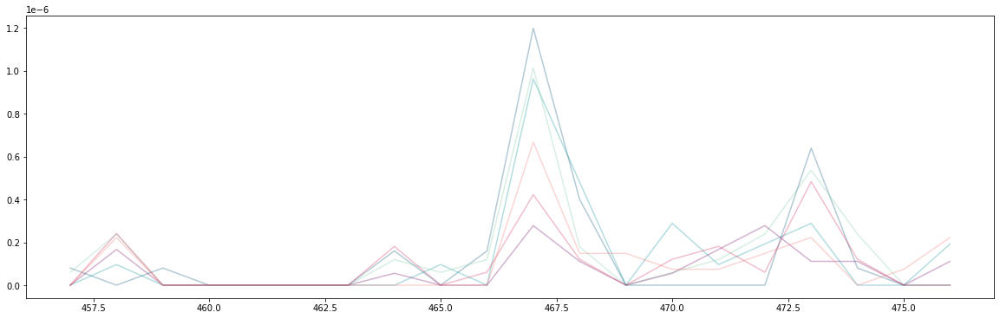

EPRS-201_110 logFC = -1.369131270518159

AAGGGAAAGA G AATA TTCTTCATGTTTCTGAAAATGTGATATT CACAGATGTGAATTCT

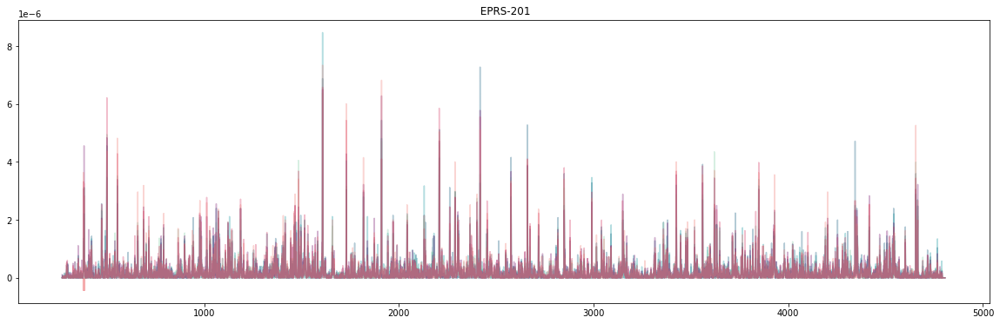

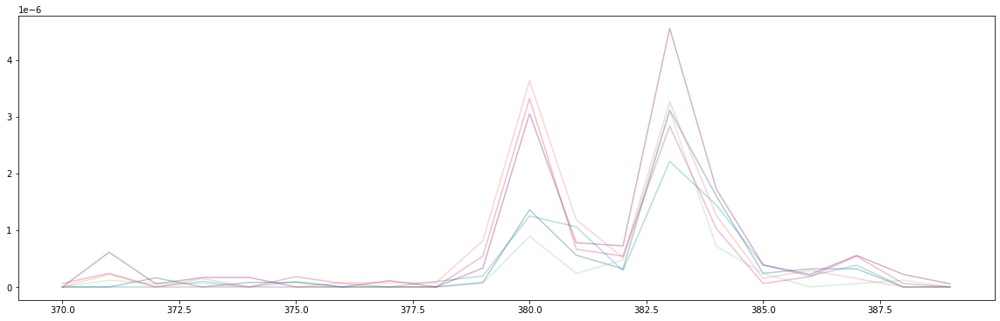

NUP205-201_3261 logFC = 1.3505620675668923

GAGAACCAGC C AGGA TTTCTTATTTTCCCAGTTGCAGTATCTA CCATTTTCTAACAAAG

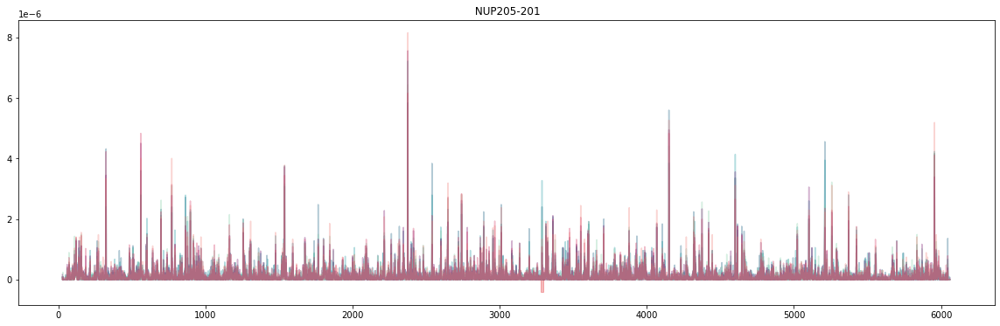

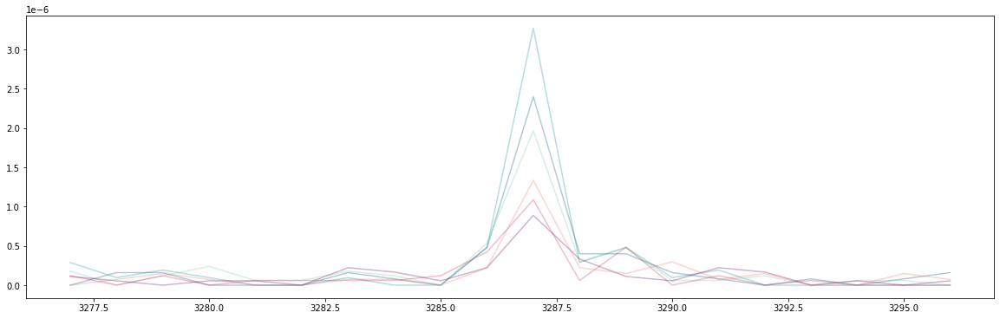

GRINA-201_866 logFC = 1.2775282561566565

TCCTGGTGAG C ATGG TGGTGCTCTTCATCTTCGCCATTCTCTG CATCTTCATCCGGAAC

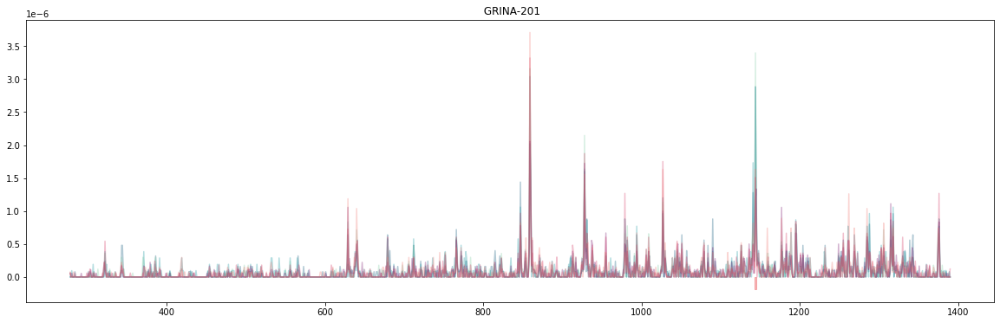

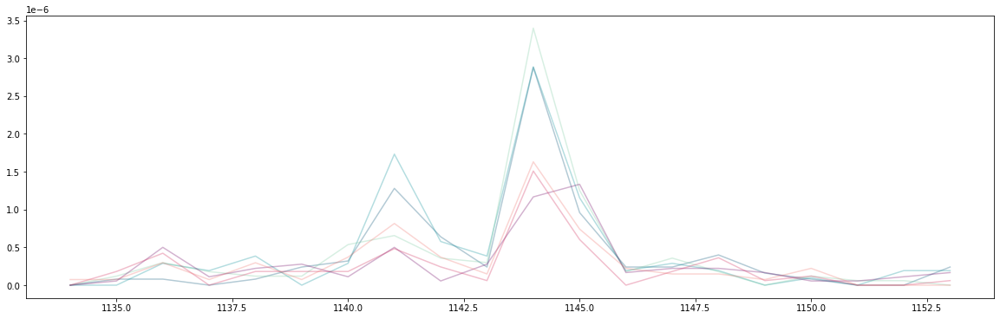

TMEM41B-204_564 logFC = -1.2350146946282103

ATGGTCACAG C AGGT TGAACGTCATAGAGAACATCTCATTAAC TACATTATATTTTTGA

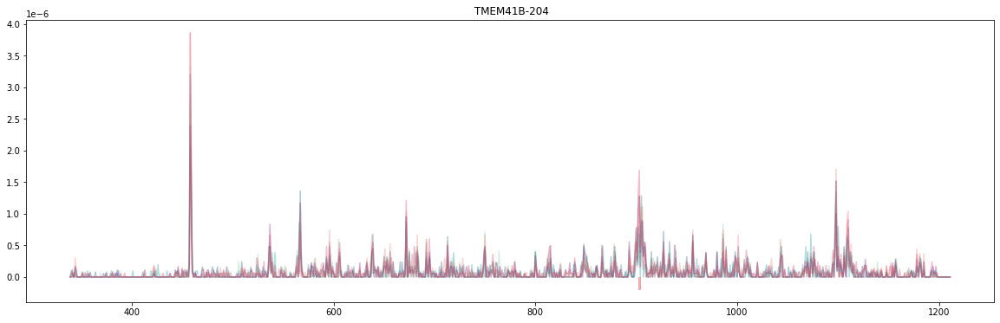

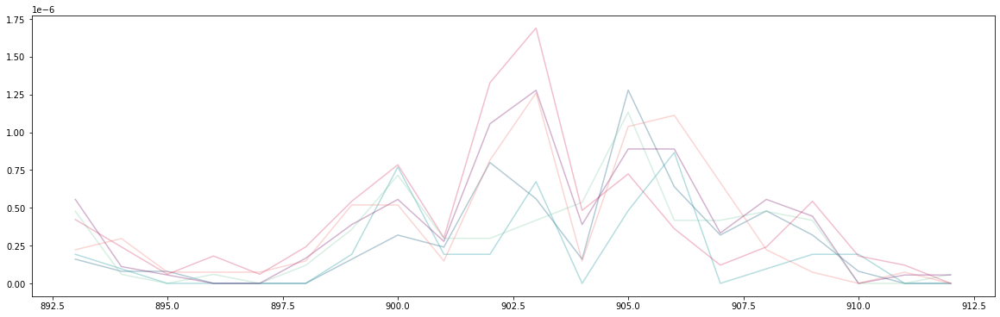

WDR61-201_587 logFC = 1.2116495784574972

TTCGCTCCTT G ACCT TTTCCCCGGACTCCCAGCTCCTTGTCAC TGCTTCAGATGATGGC

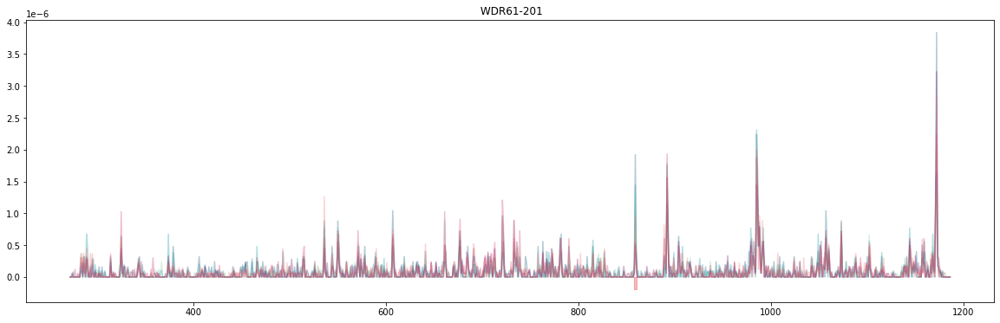

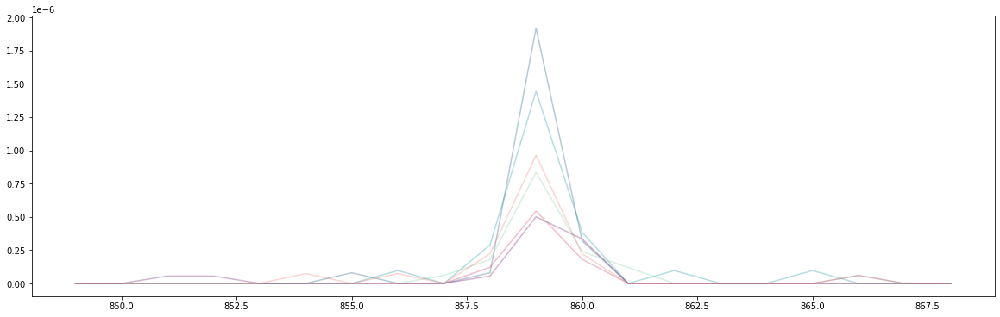

PPID-201_1046 logFC = -1.14632524955493

AATTGCTGAA A GTCA AACAAAAGATAAAGGCACAGAAAGATAA AGAGAAGGCAGTATAT

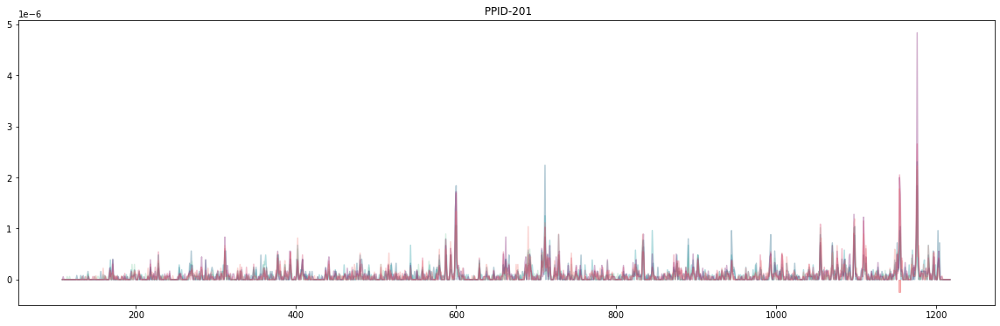

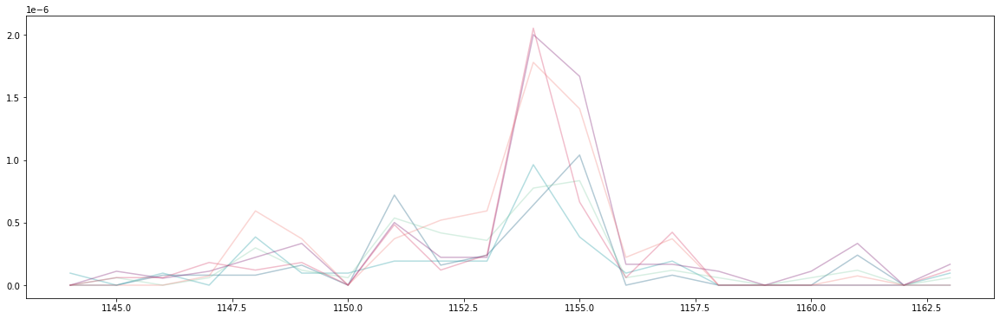

RPA1-201_879 logFC = 1.054509947724876

GGACGACCAT C ATTT ACCTACGGTTCAGTTTGATTTCACGGGG ATTGATGACCTCGAGA

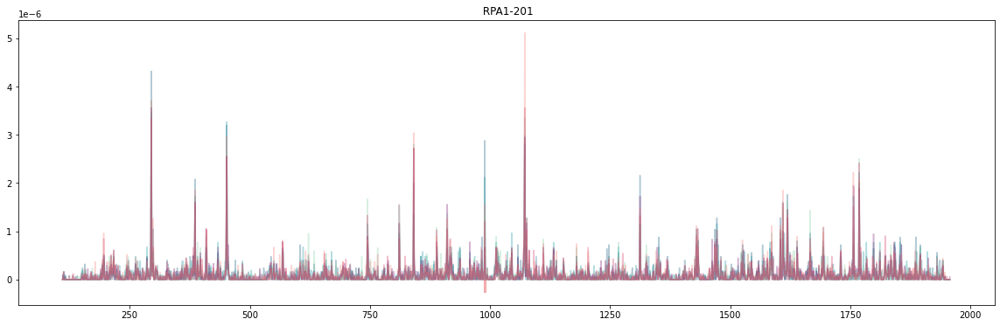

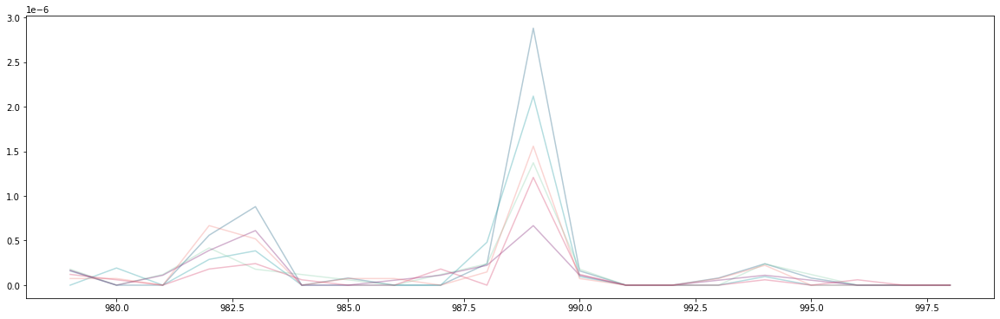

MARCKS-201_452 logFC = -0.9715848908534768

ACGAGACCCC G AAAA AAAAAAAGAAGCGCTTTTCCTTCAAGAA GTCTTTCAAGCTGAGC

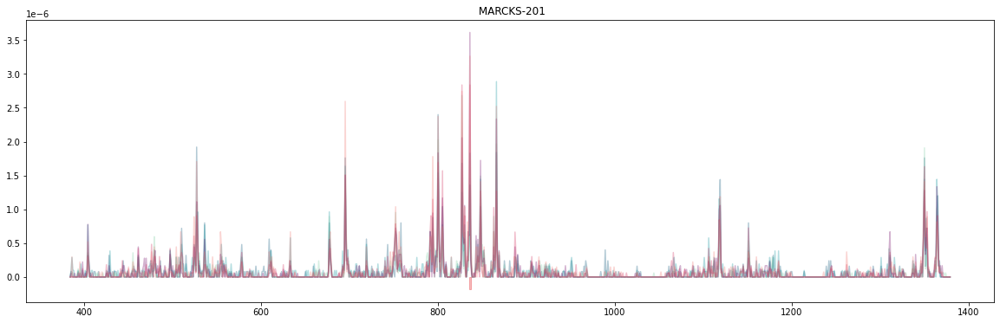

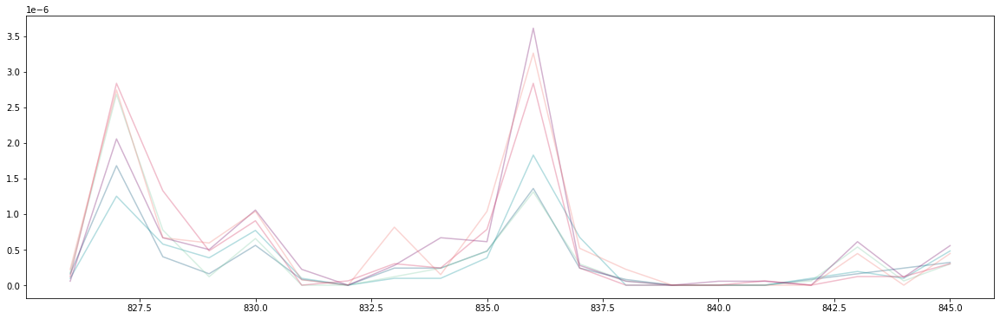

SRP68-201_713 logFC = -0.9692109851603452

AACGTGTGGA A GAGA TTTCACCCAACATCCGCTATTGTGCATA TAATATTGGGGACCAG

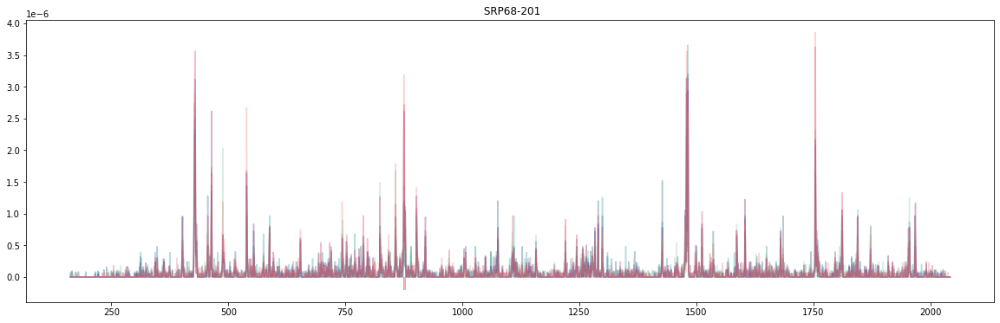

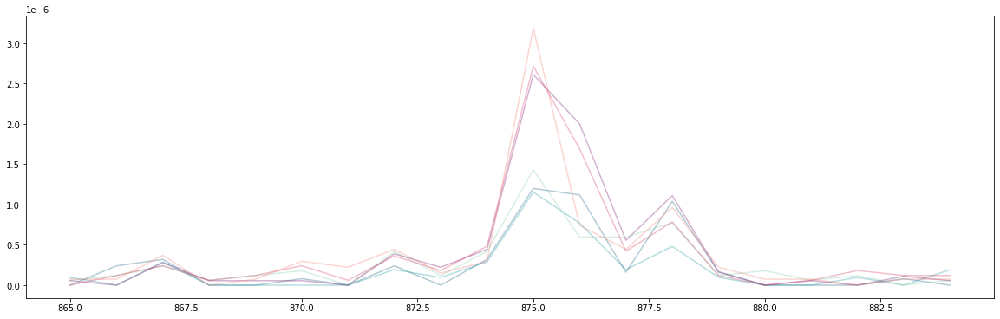

USO1-204_1331 logFC = 0.9552948118808033

CTGTGGCCCT T GCCC ATGCGTTGCAAGAAAATGCCACCCAGAA AGAACAGTTGCTCAGG

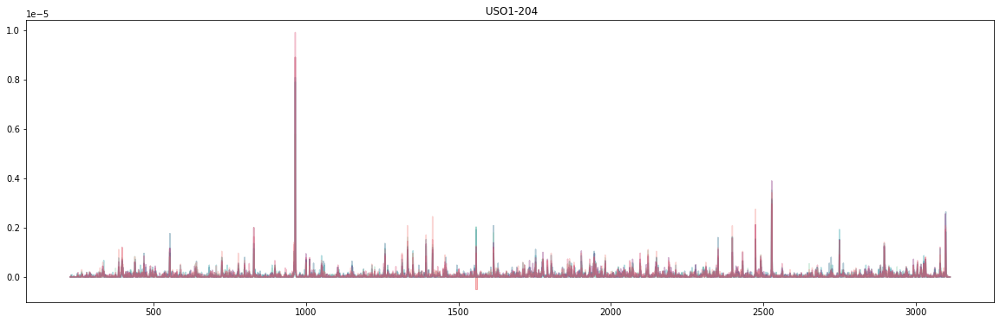

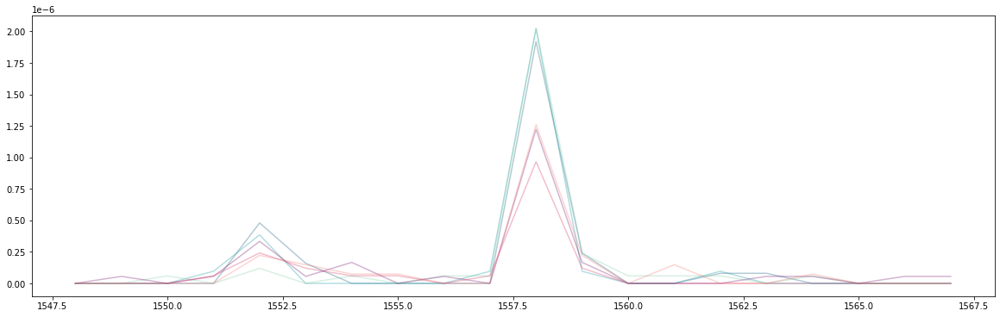

CAND1-208_329 logFC = 0.9412972805860177

GTATTGGTCT T AAAA CAGTAATTGGAGAACTTCCTCCAGCTTC CAGTGGCTCTGCATTA

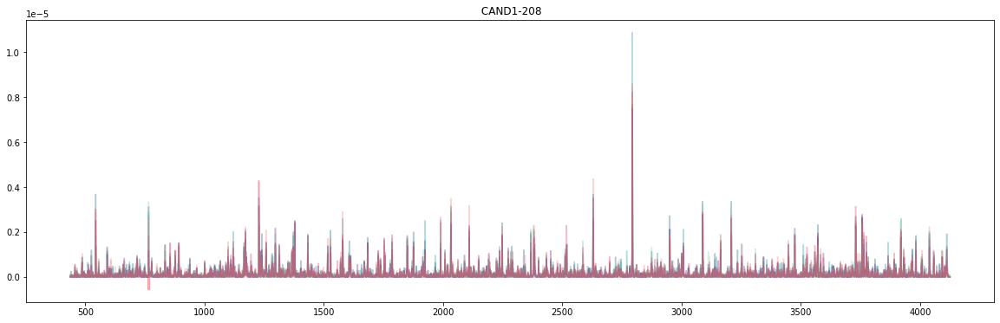

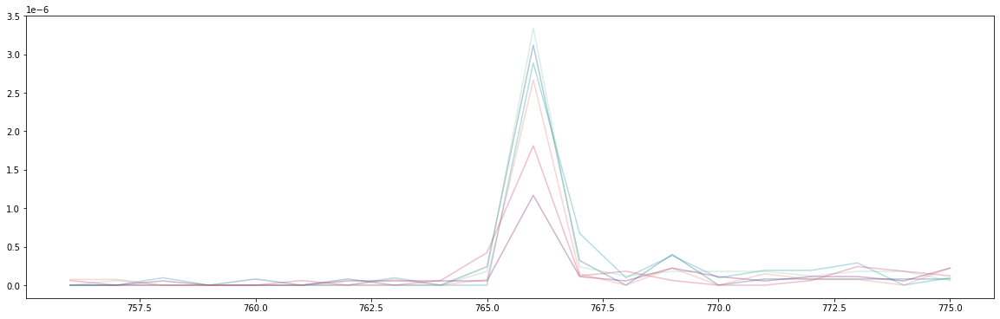

NUP205-201_5184 logFC = 0.934639467900539

TGACAGACTG C GTCA GTTTAAATTTCAAGACGATAATGTGGAG GGAGATAAAGTAAGCA

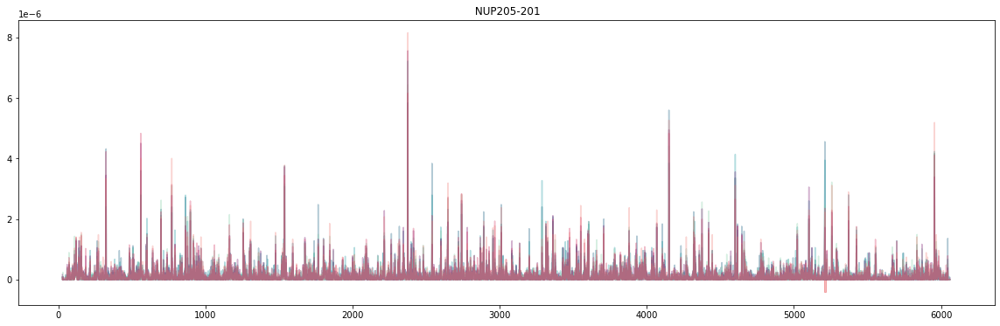

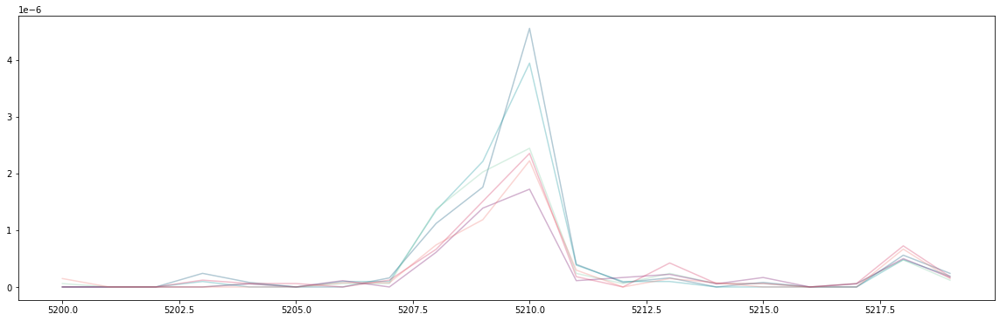

C1QBP-201_776 logFC = 0.9102339206378666

TGGTGGAGCT C AGCA CAGCCCTGGAGCACCAGGAGTACATTAC TTTTCTTGAAGACCTC

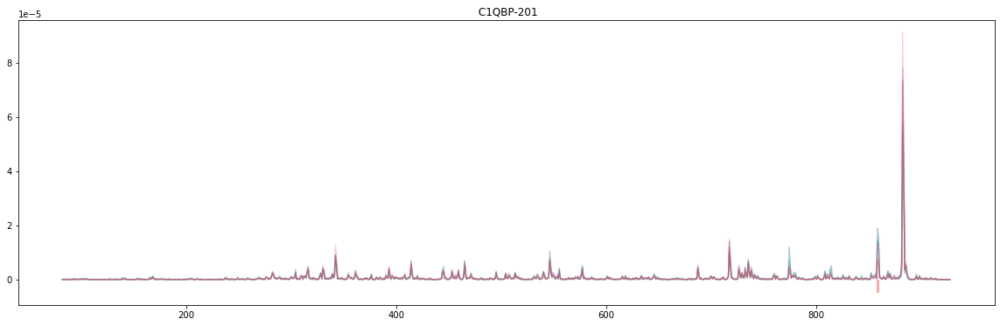

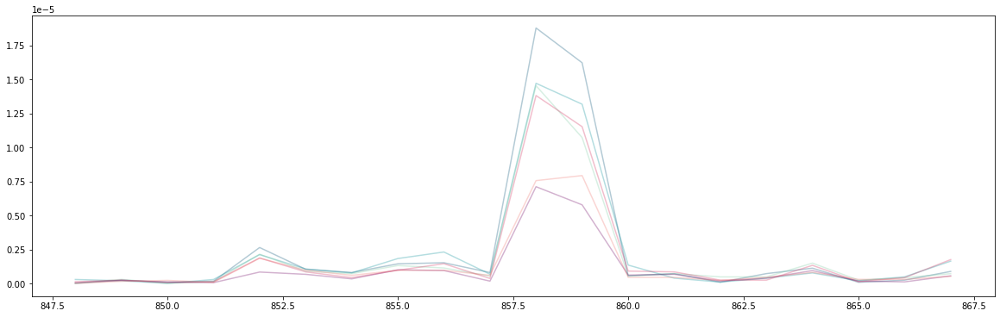

CCNB1-201_467 logFC = 0.9024868517879061

TAAATGATGT G GATG CAGAAGATGGAGCTGATCCAAACCTTTG TAGTGAATATGTGAAA

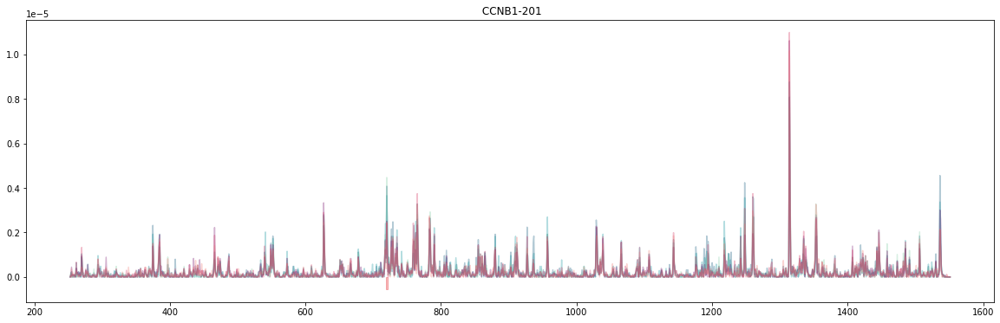

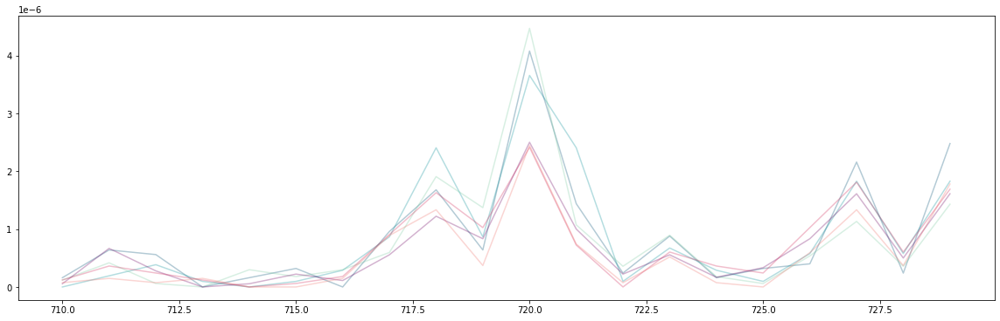

DDX46-201_1572 logFC = 0.8759832820491175

AAGAGTGACA T ATGT TGTTTTAGATGAAGCAGACAGAATGTTT GACATGGGTTTTGAAC

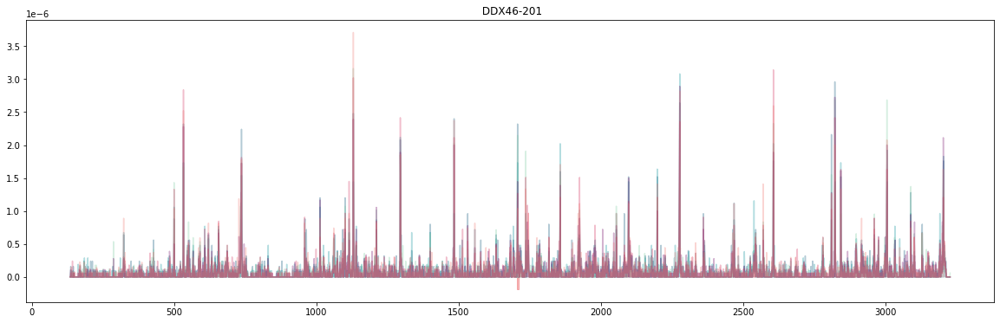

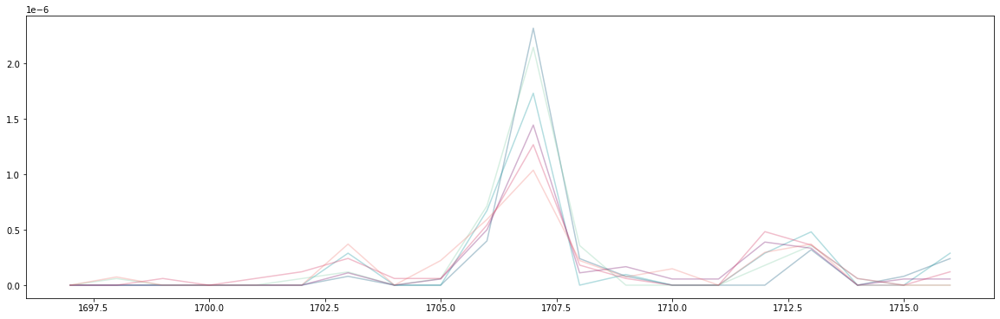

LSM4-203_161 logFC = 0.8737260175244962

ACAAGTTCTG G CGGA TGCCCGAGTGCTACATCCGCGGCAGCAC CATCAAGTACCTGCGC

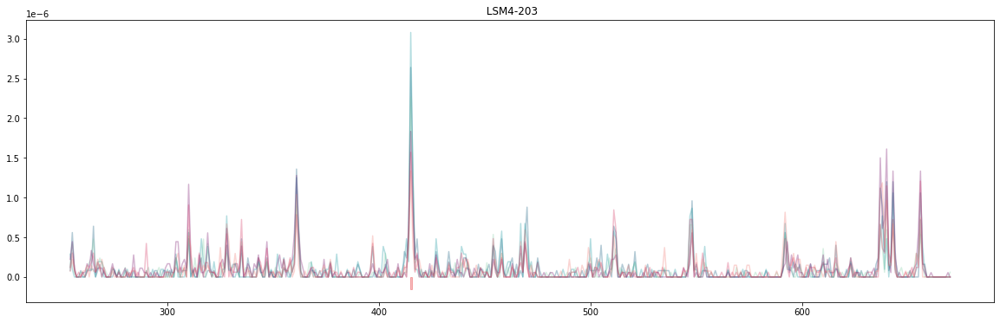

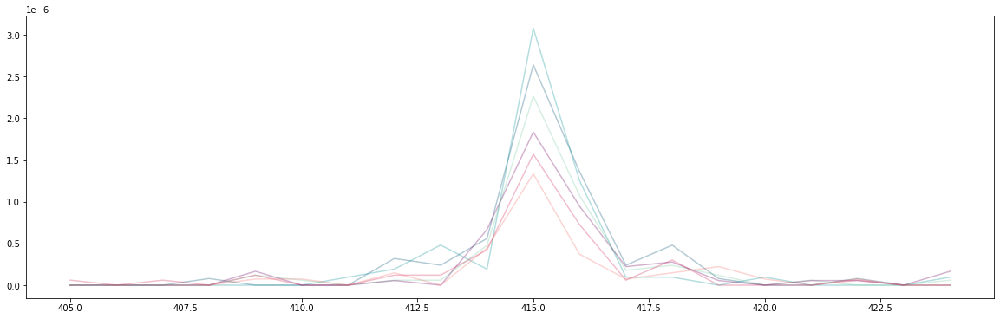

SMC3-201_2442 logFC = -0.8732455080430673

CAGACAGTTG C TAAA TGAAAGAATTAAATTAGAAGGTATTATT ACTCGAGTAGAGACTT

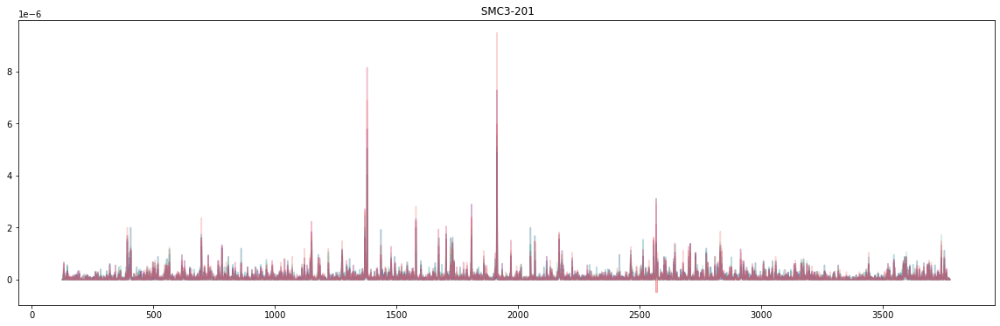

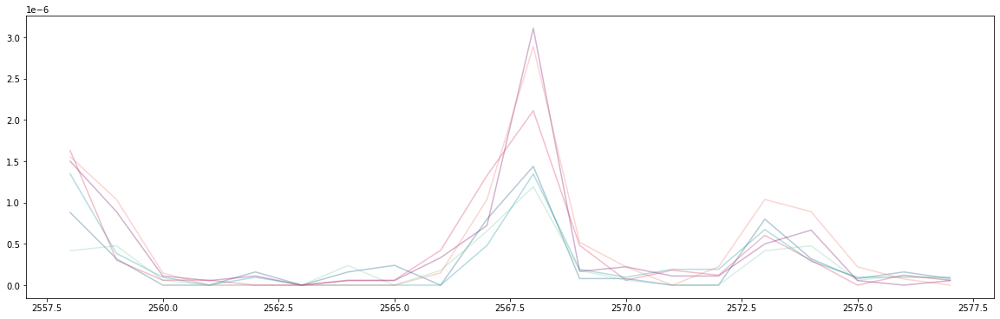

RTRAF-201_717 logFC = 0.8696286430960624

CCACAGACTG G GAAA AGTTGGAAGATGAACACTTGAGGACTTC AGCTTCTCACCTACTT

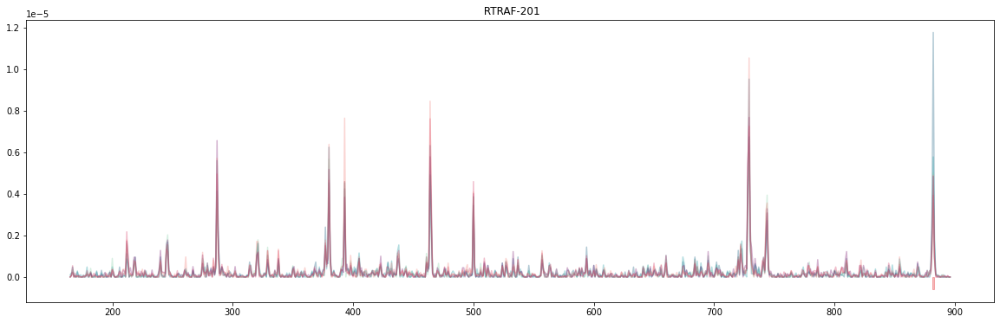

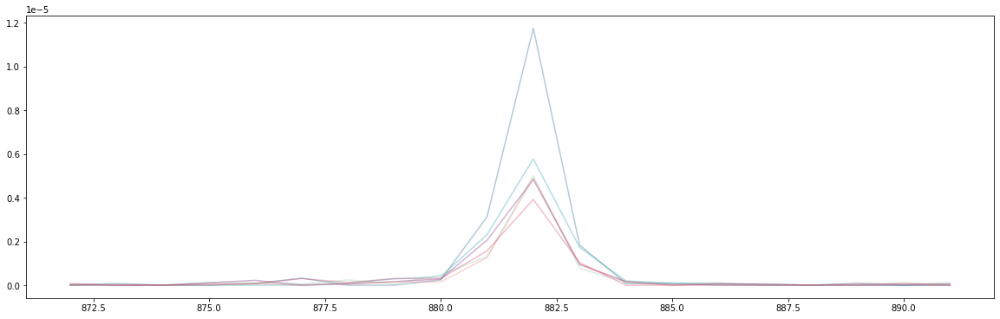

REEP5-202_524 logFC = -0.850981010661419

AAGAAGCGAA G AAAG CTACCGTGAATTTACTGGGTGAAGAAAA GAAGAGCACCTAAACC

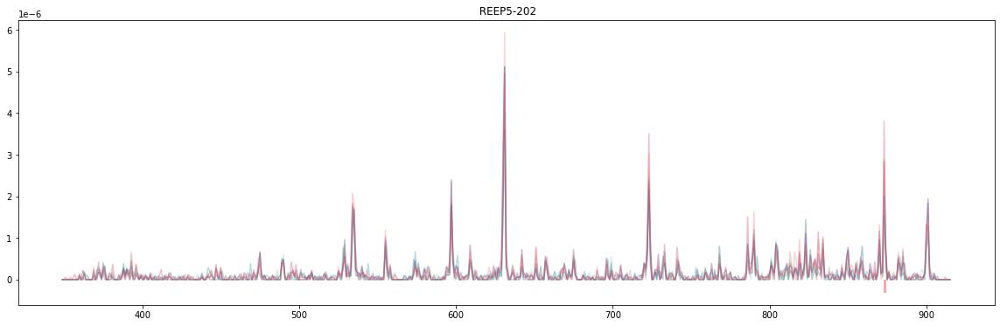

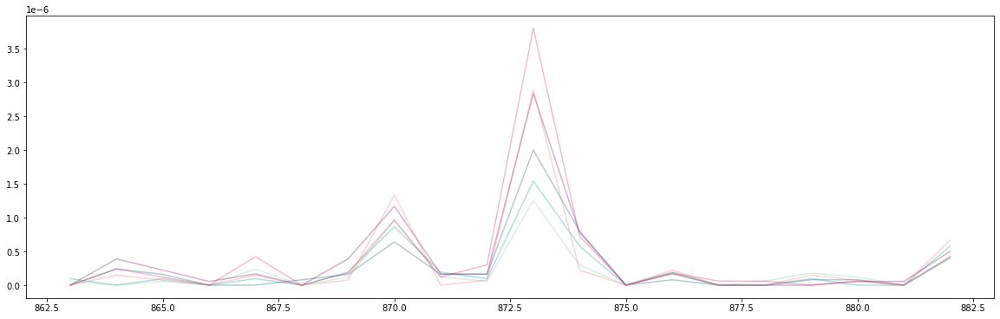

MT-ATP8-201_151 logFC = 0.8058850576083547

AACAAACCCT G AGAA CCAAAATGAACGAAAATCTGTTCGCTTC ATTCATTGCCCCCACA

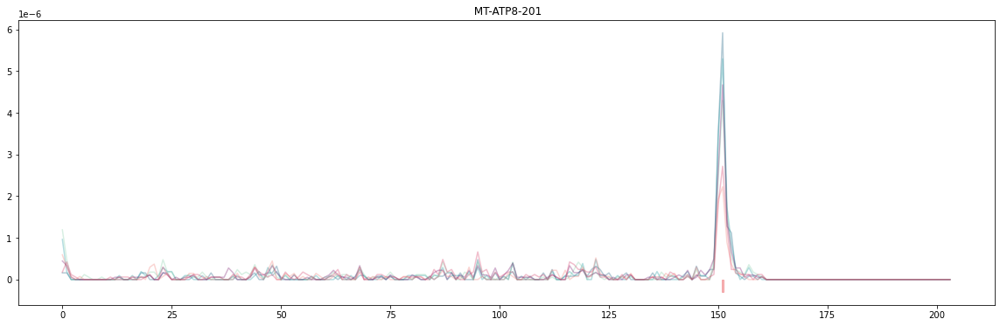

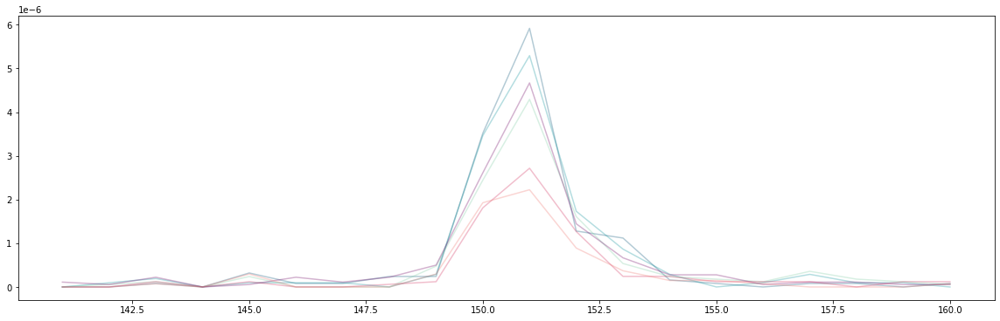

BCLAF1-214_1550 logFC = 0.8006734169600441

CTCTACACAA G AATC TGGATGCACGAGAAAAGTCTACCTTCAG AGAGGAAAGCCCACTT

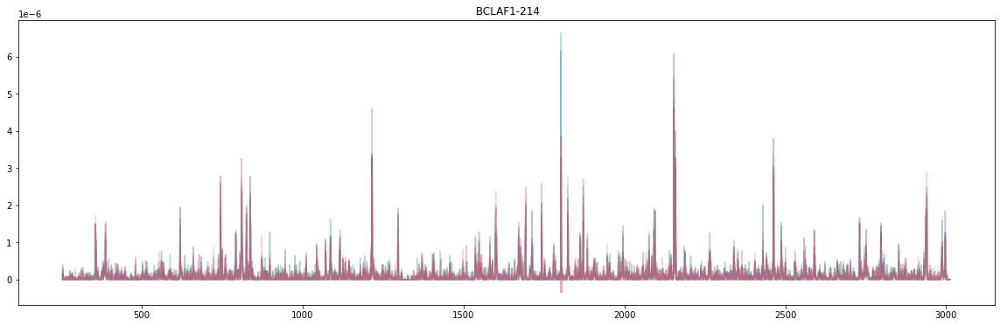

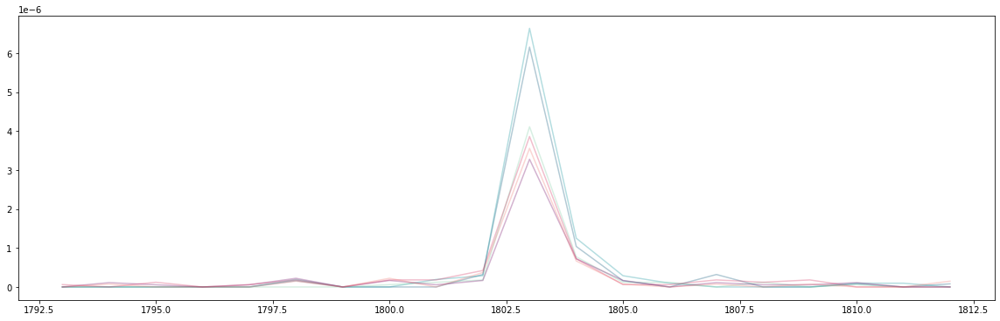

HNRNPUL1-204_2489 logFC = 0.7966450787361274

ATCAGAACCA G GGCC AGTGGCCGCCATACTACGGGAACTACGA CTACGGGAGCTACTCC

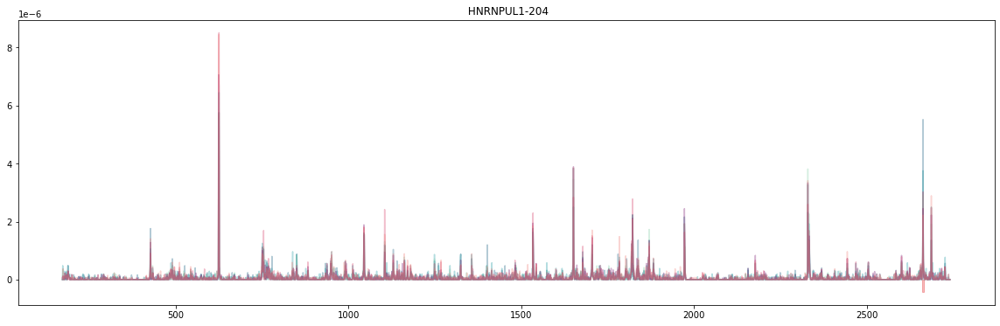

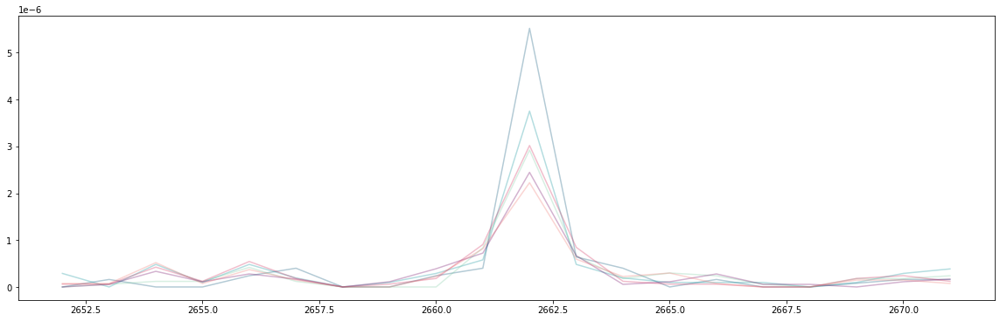

RPL36A-209_293 logFC = 0.7952265449338943

GAGATAAGAA G AGAA AGGGCCAAGTGATCCAGTTCTAAGTGTC ATCTTTTATTATGAAG

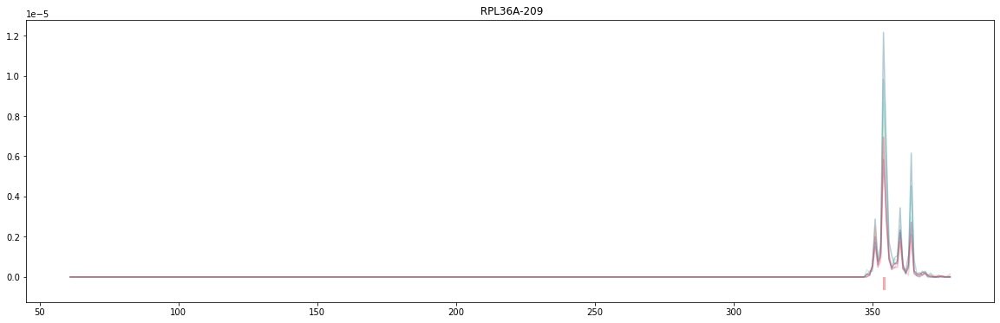

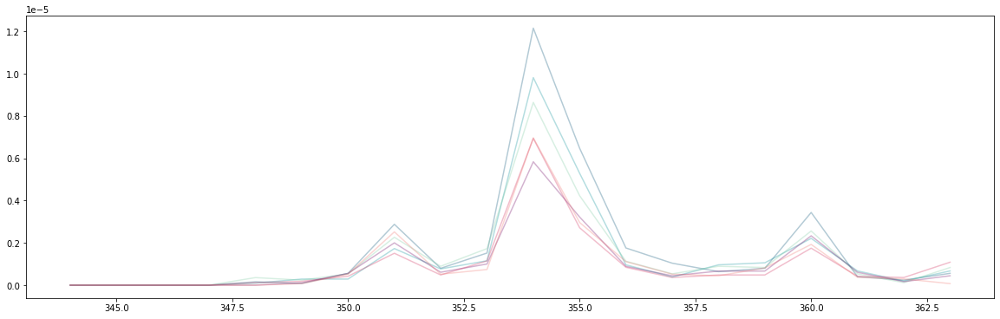

RNF138-202_578 logFC = 0.7874956480277293

CTATTTGTGT G TCTC TTCCTTGGGGAGATCCTAGCCAGATTAC CAGAAATTTCGTTAGT

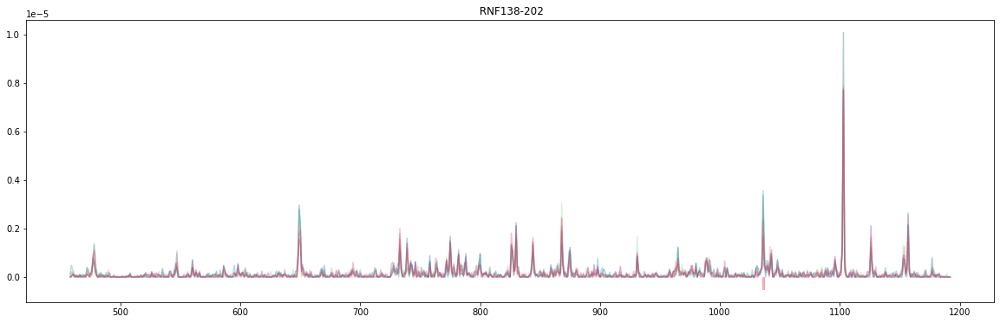

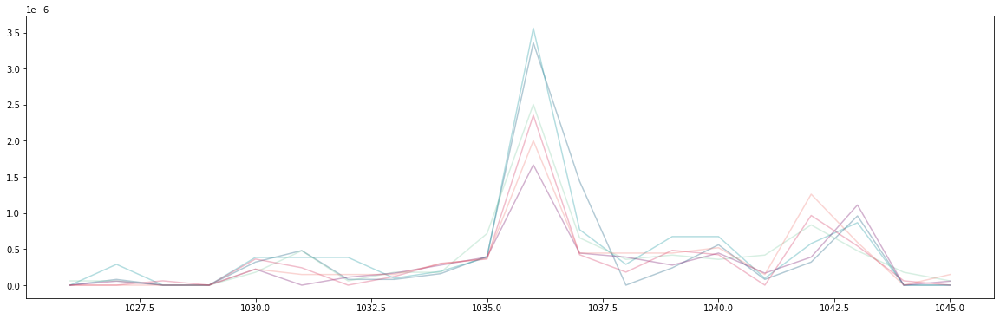

SSR1-201_336 logFC = 0.7846927488294385

CAAGGGTACA G AAGA TTTTATTGTTGAATCCTTAGATGCCTCA TTCCGTTATCCTCAGG

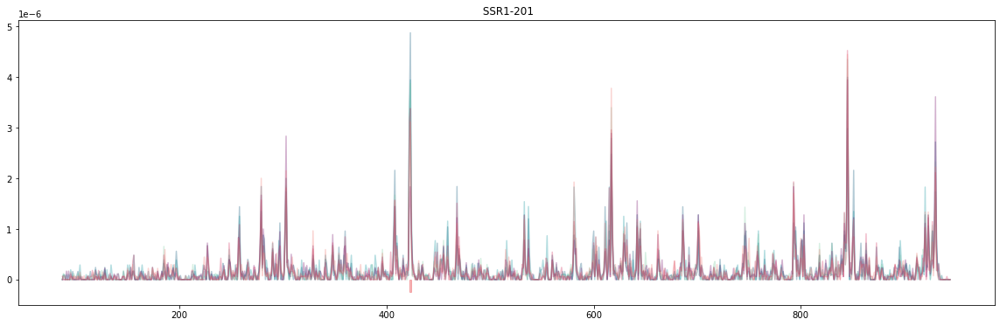

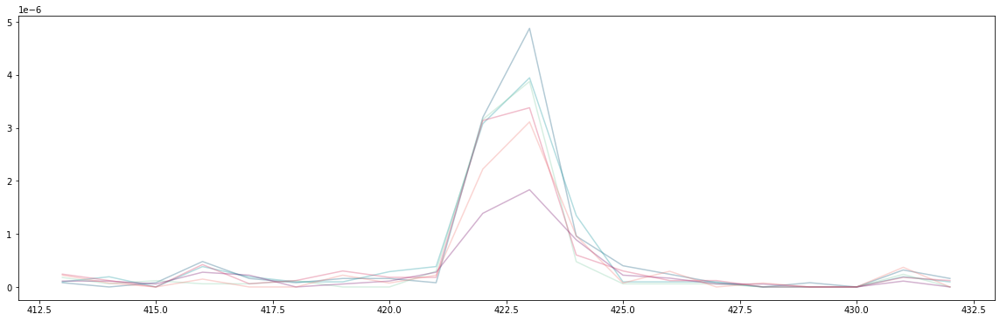

SDHD-201_321 logFC = 0.7546350483590442

CTGGGGCCTT G GACA AGTTGTTACTGACTATGTTCATGGGGAT GCCTTGCAGAAAGCTG

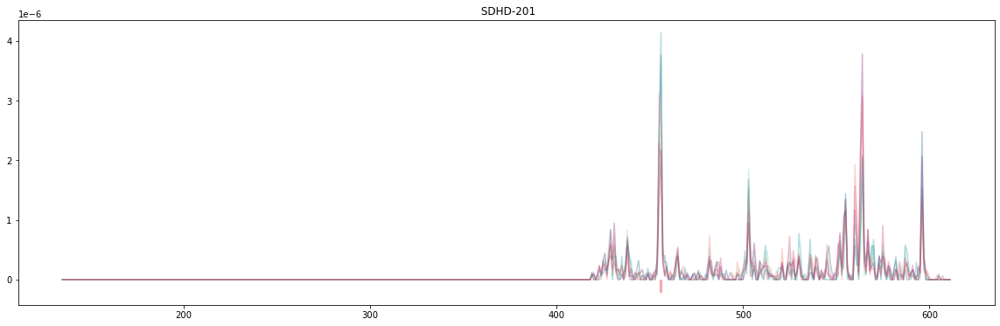

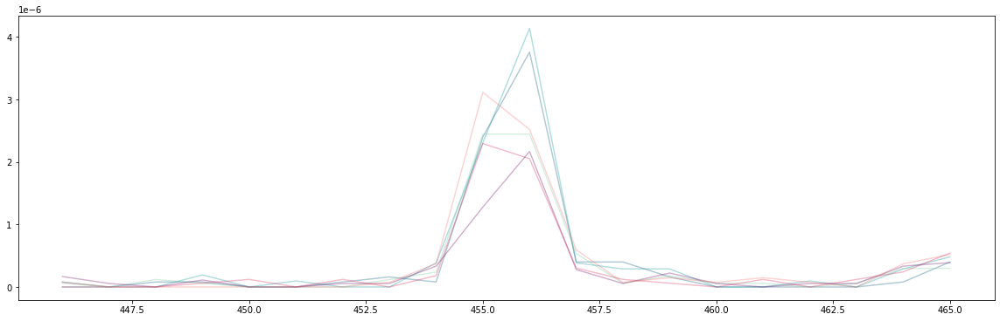

MMADHC-203_297 logFC = 0.752172401044038

TAAAACTTTG C CTGA TGTTCTAGCAGAACCTTTATCAAGTGAA AGACATGAGTTTGTGA

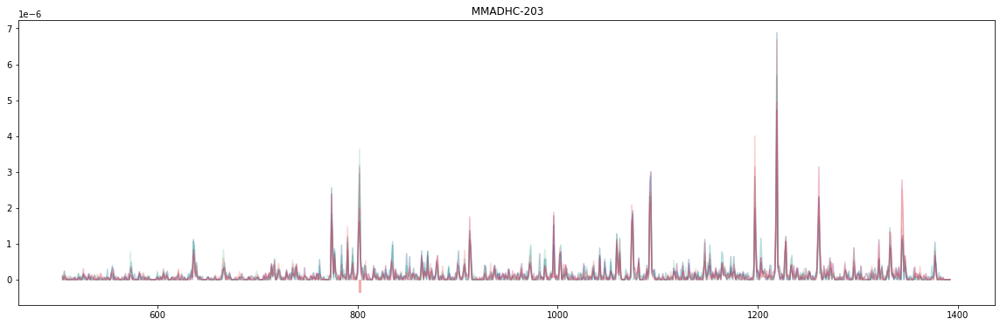

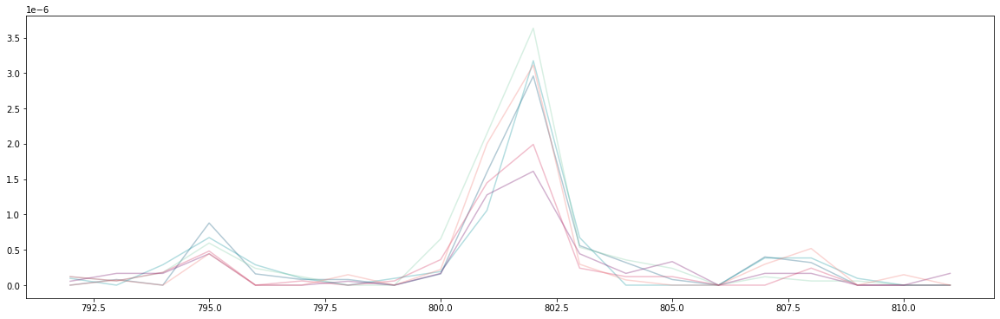

RARS-201_501 logFC = 0.733893852062938

CCACTTAAGA A AGGA TTTTGTATCAGAACAATTGACCAGTCTT CTAGTGAATGGAGTTC

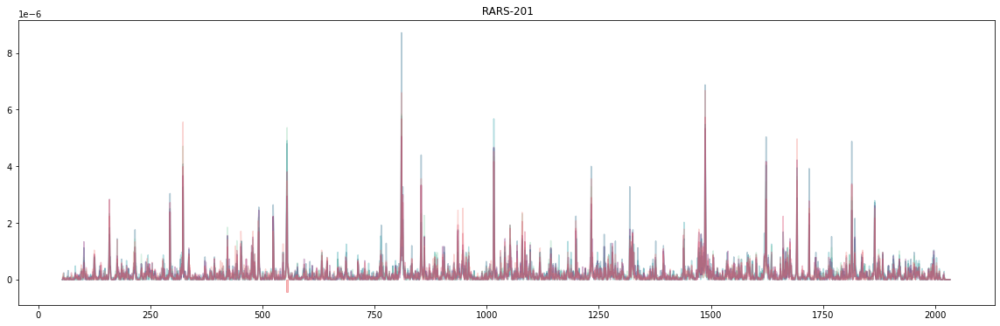

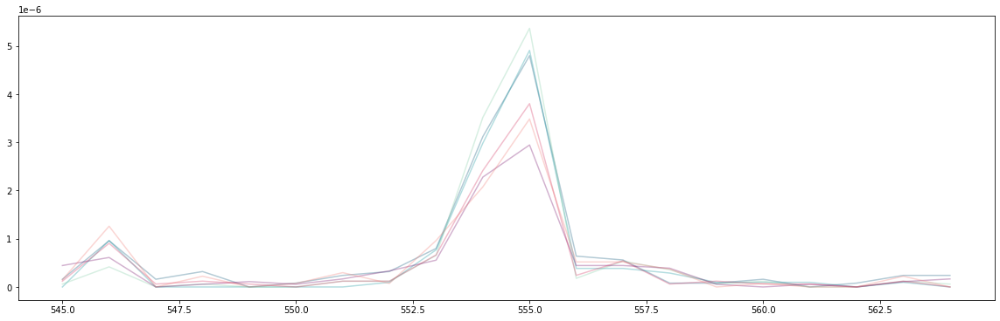

UBA1-201_674 logFC = -0.7098960393639465

CTATGGTTAC C AAGG ACAACCCCGGTGTGGTTACCTGCCTGGA TGAGGCCCGACACGGG

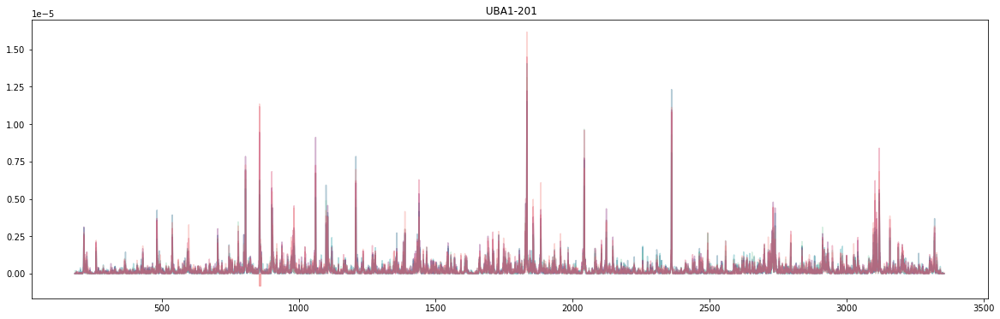

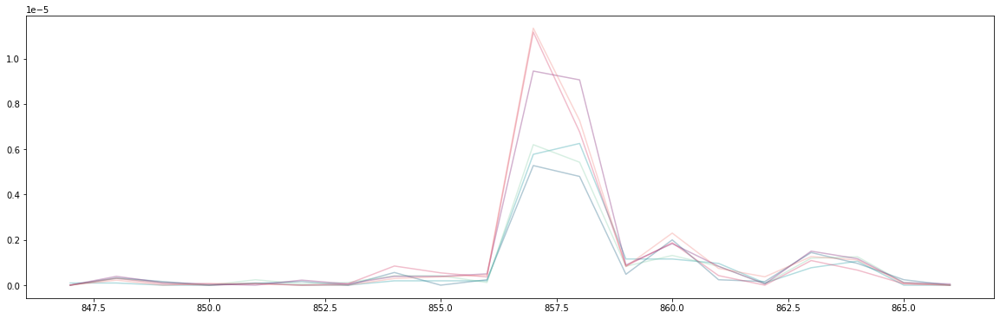

HSPD1-202_821 logFC = -0.7004136006946015

TGGTCATAAT C GCTG AAGATGTTGATGGAGAAGCTCTAAGTAC ACTCGTCTTGAATAGG

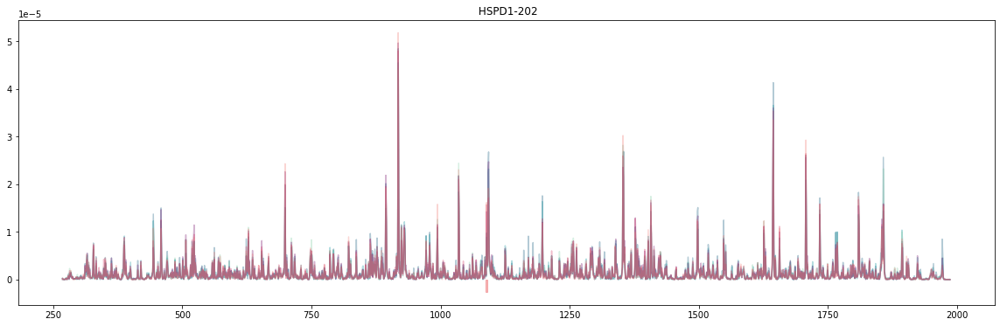

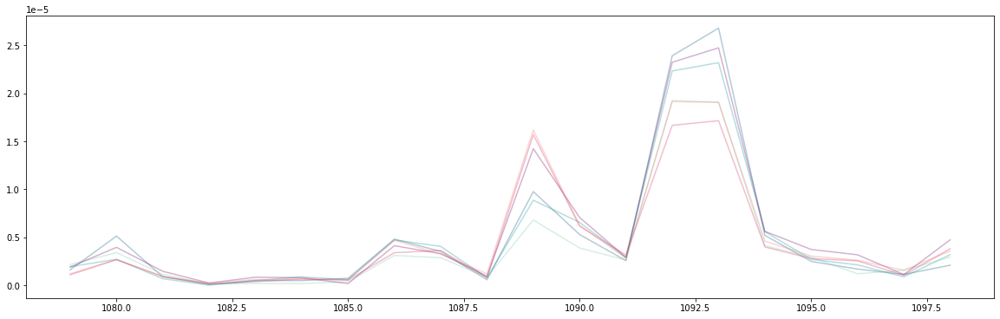

MT-ND5-201_0 logFC = 0.6682908505039008

A TAAC CATGCACACTACTATAACCACCCTAACC CTGACTTCCCTAATTC

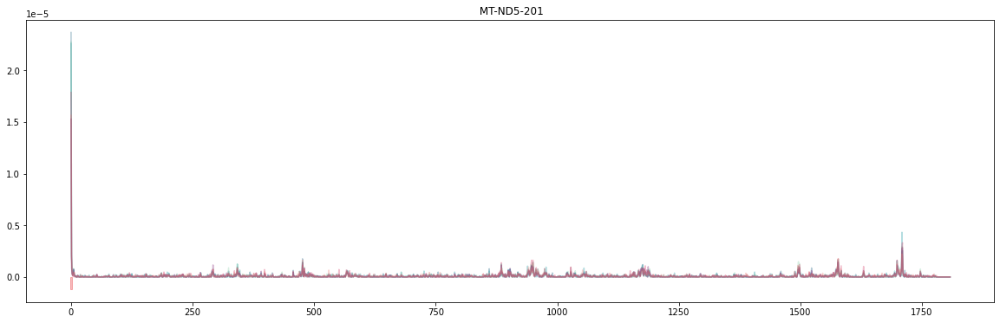

Couldn't plot this: x and y must have same first dimension, but have shapes (20,) and (0,)

HIST1H2AC-202_338 logFC = -0.6397398458215922

CTAACATCCA G GCCG TGCTTCTGCCTAAGAAGACCGAGAGTCA CCACAAGGCCAAGGGC

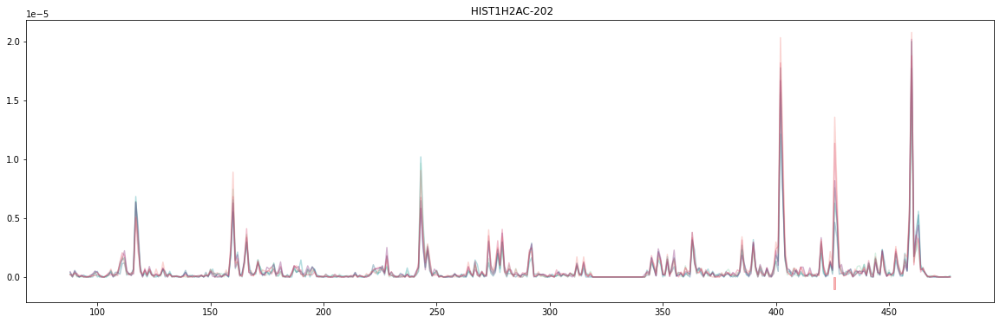

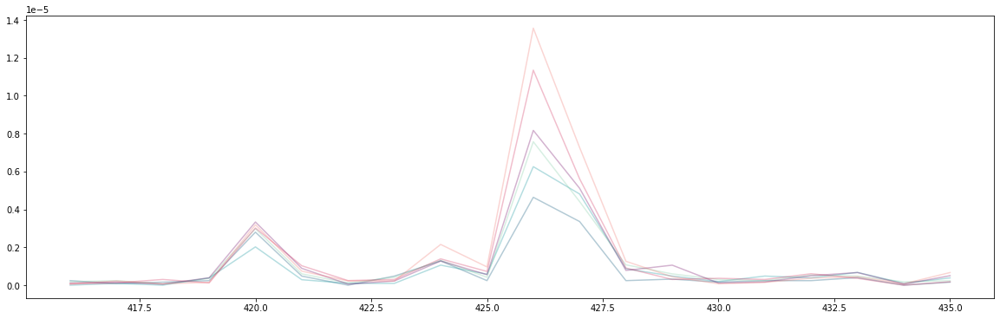

HNRNPR-202_773 logFC = -0.6126579380715413

AGAATAAGAC T AAAG AAAACATTTTGGAAGAATTCAGTAAAGT CACAGAGGGTTTGGTG

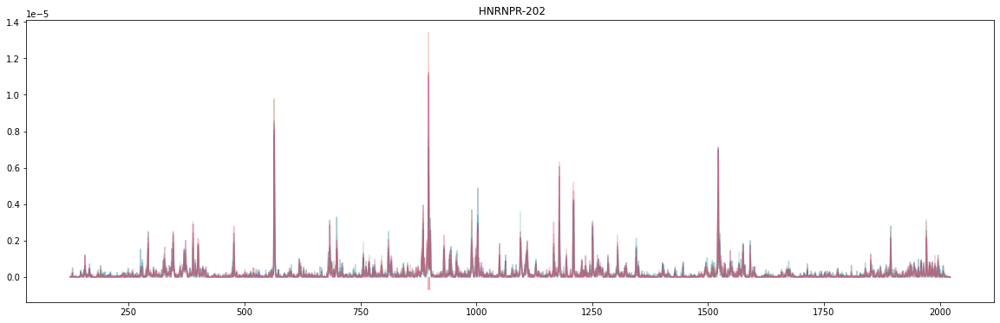

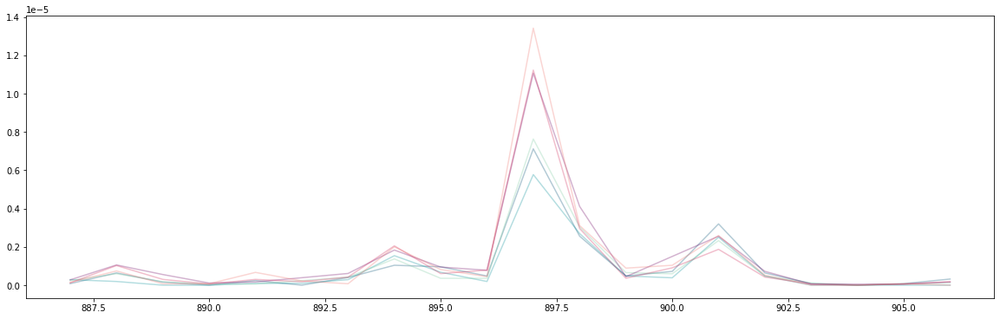

PTGES3-201_36 logFC = 0.6057362128577292

CGATCGAAGG G ACTA TGTCTTCATTGAATTTTGTGTTGAAGAC AGTAAGGATGTTAATG

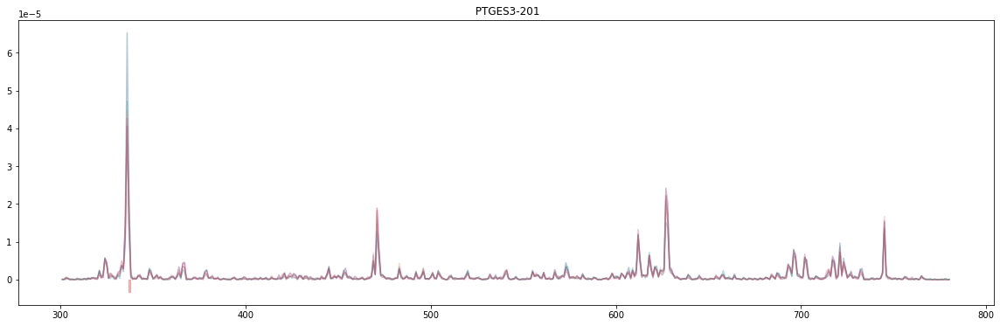

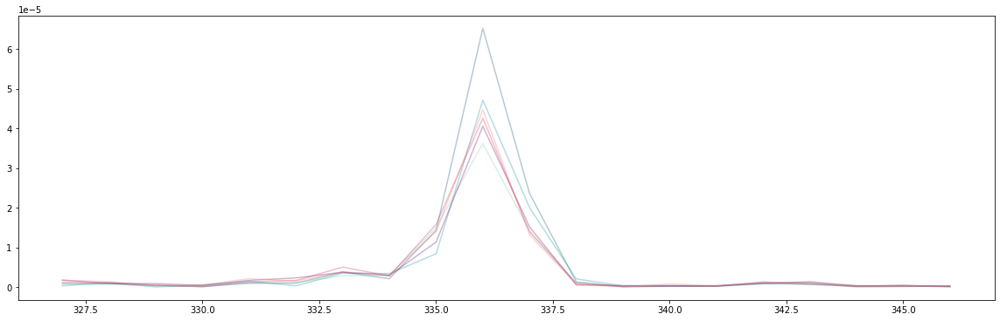

HSPD1-202_1589 logFC = 0.5965225591876587

CTGCTTTATT G GATG CTGCTGGTGTGGCCTCTCTGTTAACTAC AGCAGAAGTTGTAGTC

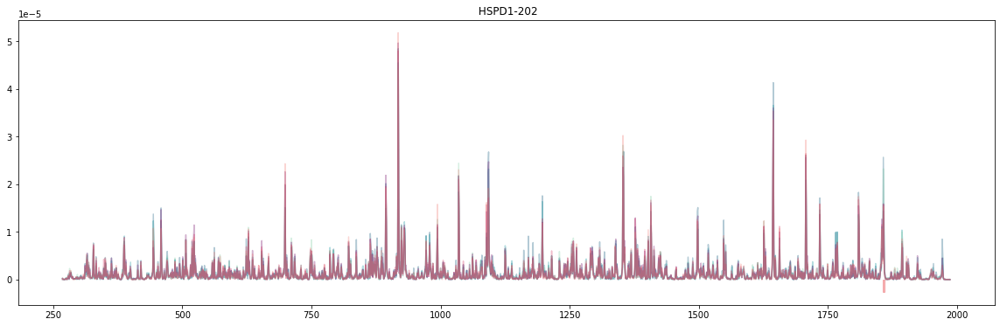

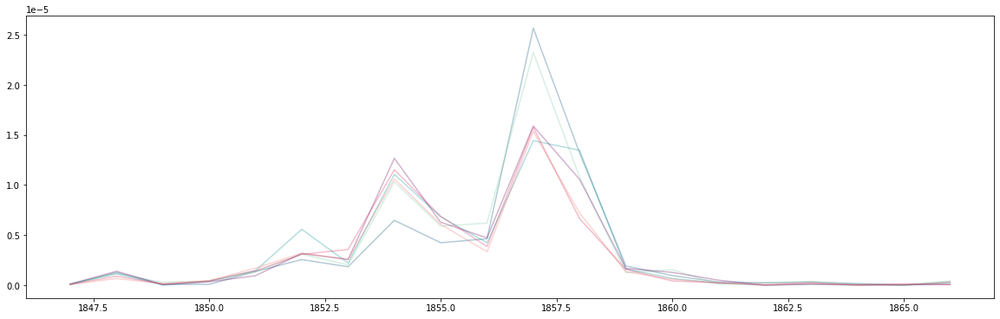

PSMA7-203_650 logFC = -0.5583214361896335

ATCAATCCCT C AAGA TTTTAAATCCTGAAGAAATTGAGAAGTA TGTTGCTGAAATTGAA

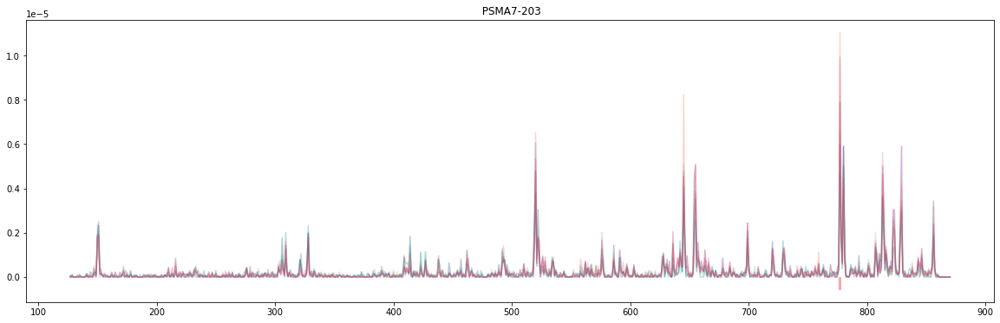

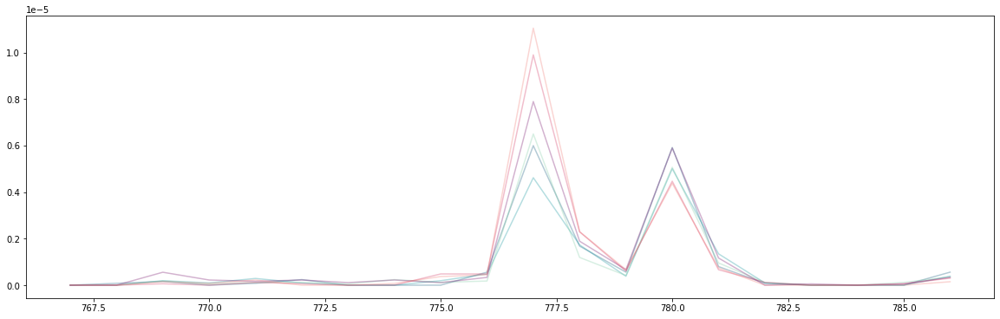

UQCR10-201_158 logFC = -0.5309416865320918

GGAAGCTGTG G AAAC ACATCAAGCACAAGTATGAGAACAAGTA GTTCCTTGGAGGCCCC

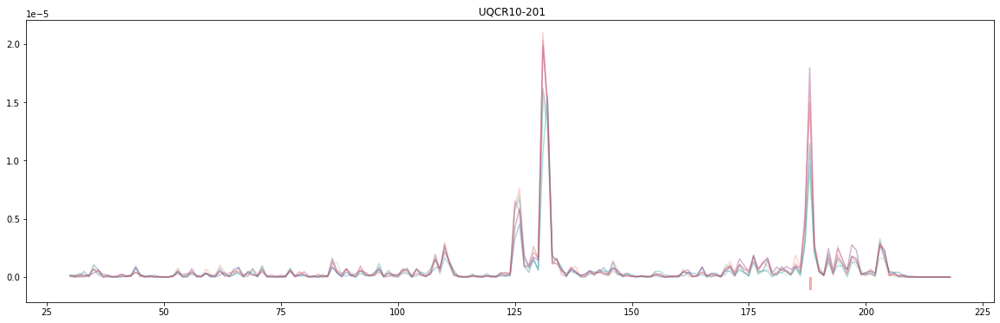

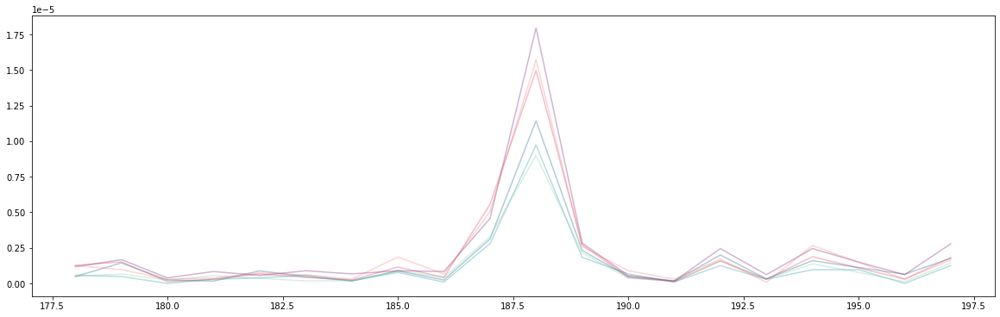

In [20]:
for s, log_FC in level_1_sites:
    display_html("<center><b>{}</b><br>logFC = {}</center>".format(s, log_FC), raw = True)
    gene, position = s.split("_")
    position = int(position)
    adjusted_position  = adjust_position(position, gene, coverages)
    get_sequence( gene = gene, sequence_dict = gene_sequences, position = adjusted_position )
    
    
    try:
        plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = NSP_experiments,
                  gene_name   = gene , 
                  pause_site  = adjusted_position,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)
        plt.show()
    except Exception as this_exception:
        display_html("Couldn't plot this: {}".format(this_exception), raw = True)
    
    
    try: 
        plot_pause_site(\
                  coverages   = coverages,
                  experiments = NSP_experiments, 
                  pause_site  = adjusted_position,
                  gene_name   = gene,
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)
        plt.show()
    except Exception as this_exception:
        display_html("Couldn't plot this: {}".format(this_exception), raw = True)
    

## Level 2 Pause Sites

The genes of pause sites are differentially translated. However, the diffrence of the log fold changes between the
pause site and the gene are more than 

In [21]:
with open("level_2_diff_pause_sites.pick", "rb") as pickle_in:
        level_2_sites = pickle.load(pickle_in)

EIF4B-201_1818 logFC = 2.022716408490559

AAATGAGGGA G AAGA TTATGCCGAATAGACCTCTACATCCTGT GCTTTTCTCCTAGTTT

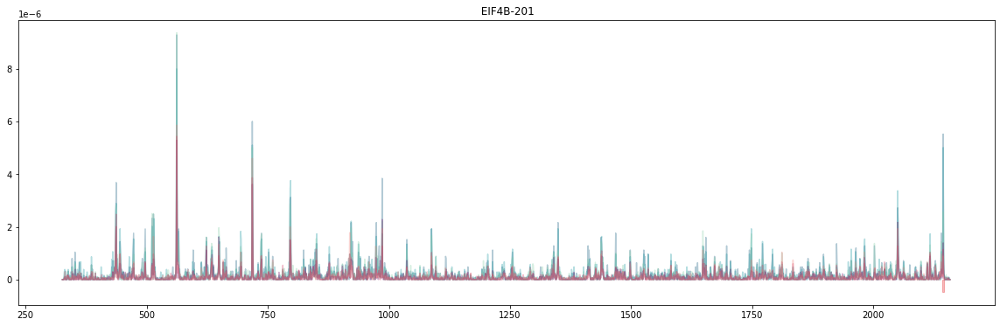

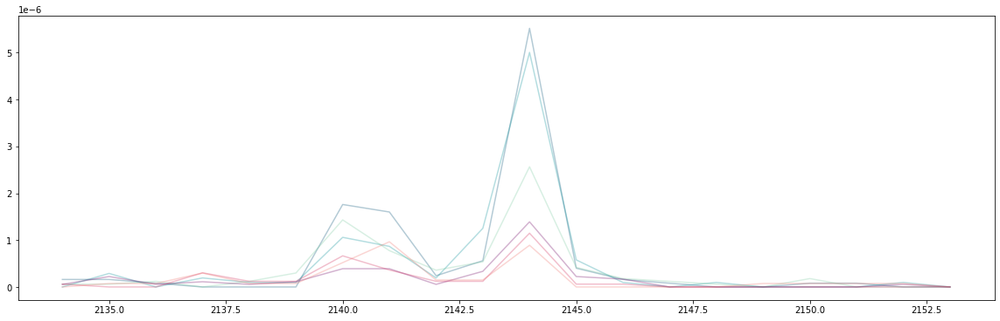

DDIT4-201_249 logFC = -2.0113424774409796

CTTCGAGCTG C TCAG TGACCCTGAGGATGAACACTTGTGTGCC AACCTGATGCAGCTGC

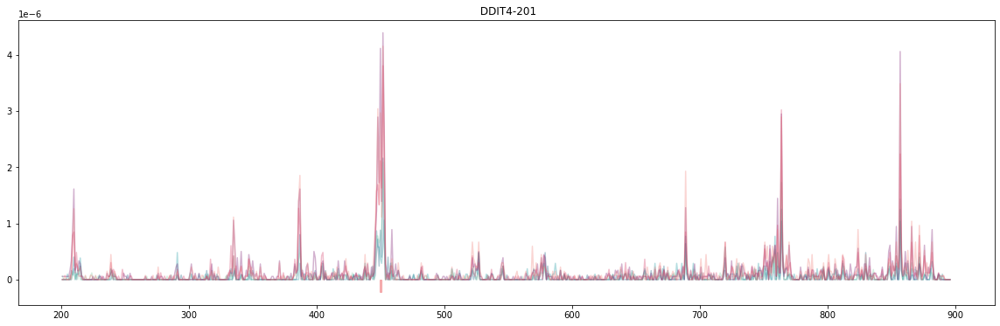

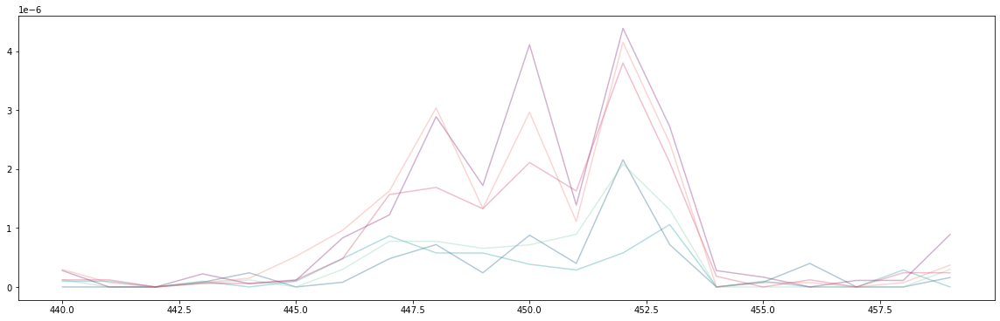

SMARCB1-213_731 logFC = 1.5010736920377896

TCAGACAGCA G ATCG AGTCCTACCCCACGGACAGCATCCTGGA GGACCAGTCAGACCAG

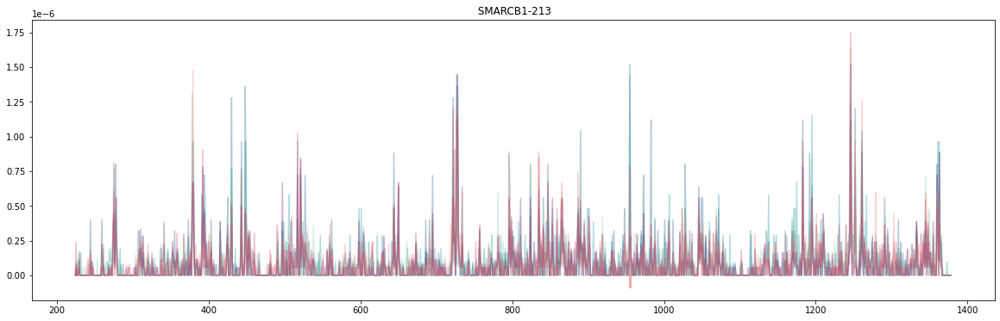

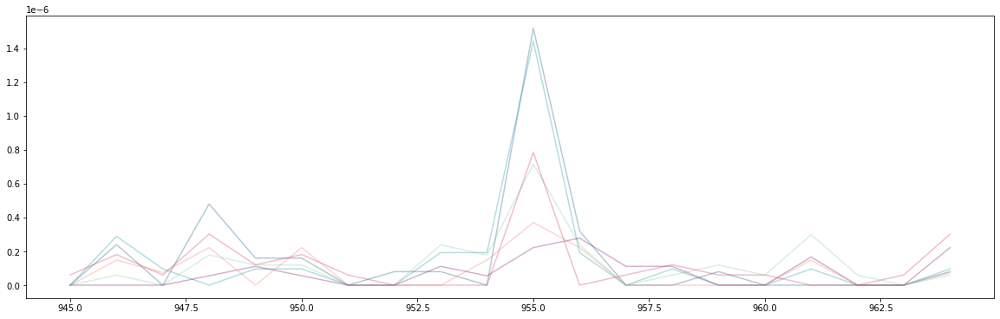

DPY30-202_275 logFC = -1.46529805838149

TAAAAAACAA G GCAC AGTTTGAAGATCGAAACTGACTTAATGG GAAGAACAGAAAAATT

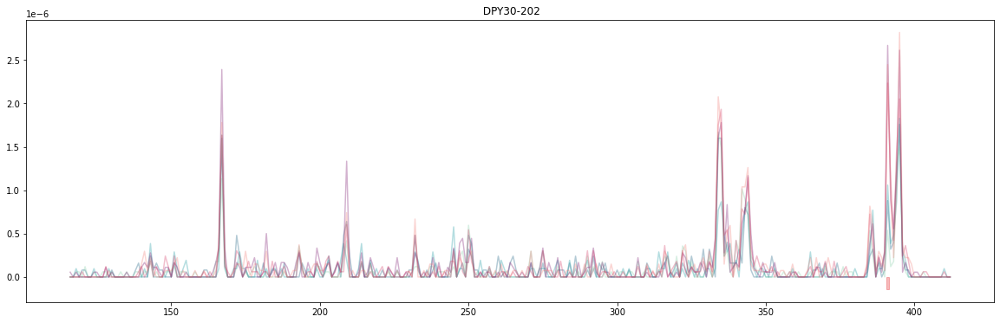

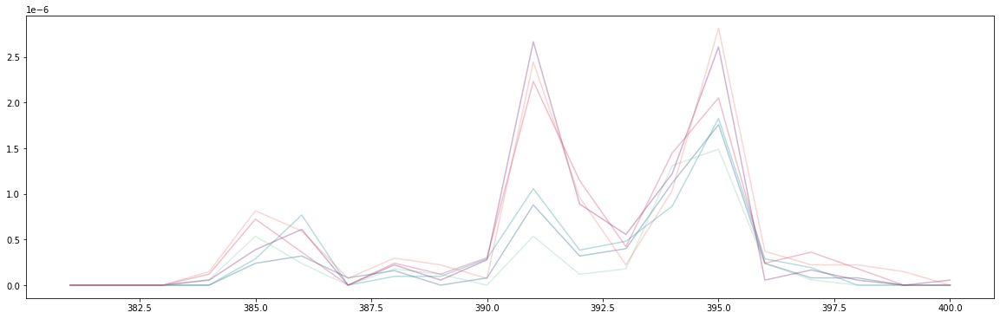

PPA2-201_185 logFC = -1.3553868570656111

ACATTTCCCC C TTTC ATGATATTCCTCTGAAGGTGAACTCTAA AGAGGAAAATGGCATT

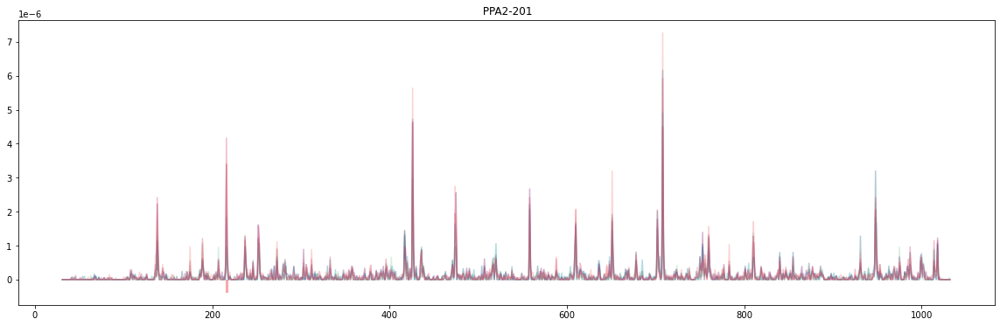

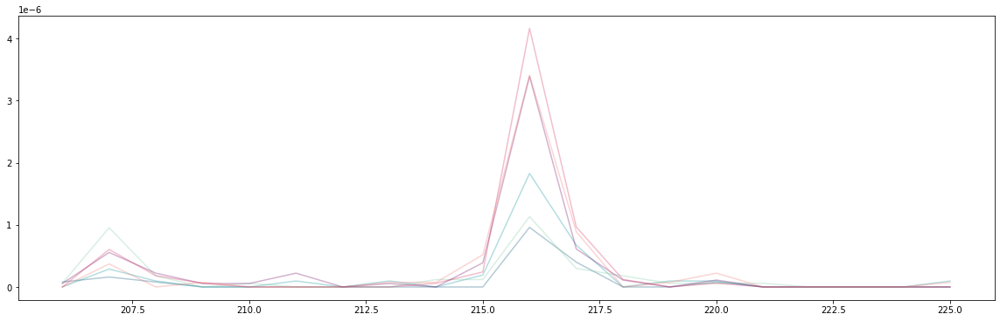

ADSS-201_600 logFC = 1.255769758327694

TCTAGCTAAC C AATA CAAATCTATATACCCCACTTTGGAAATA GACATTGAAGGTGAAT

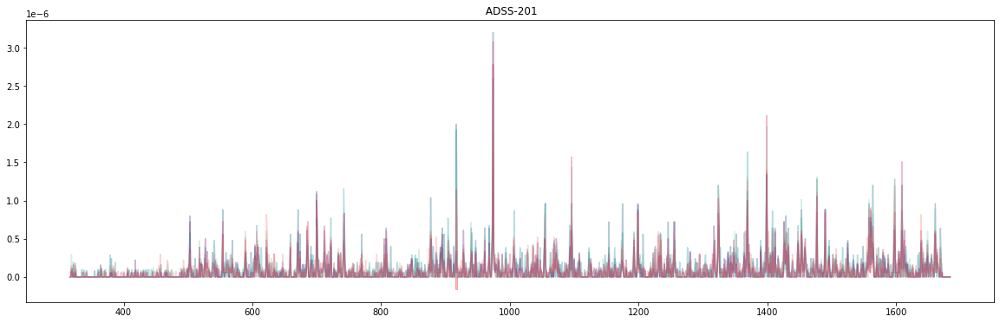

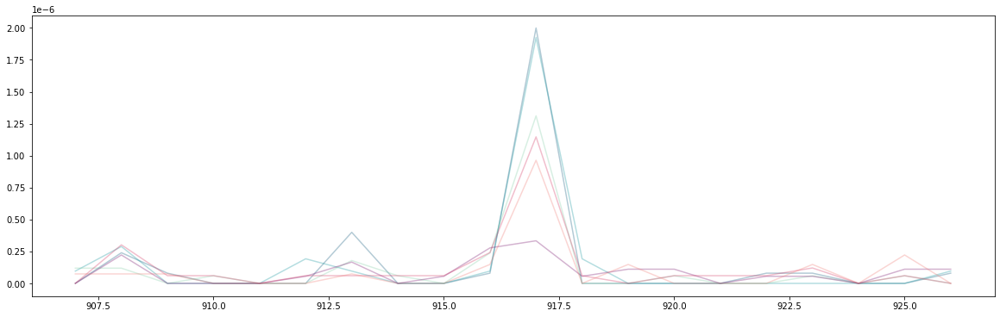

ARF1-214_336 logFC = 1.227030601304681

GATGCTGGCC G AGGA CGAGCTCCGGGATGCTGTCCTCCTGGTG TTCGCCAACAAGCAGG

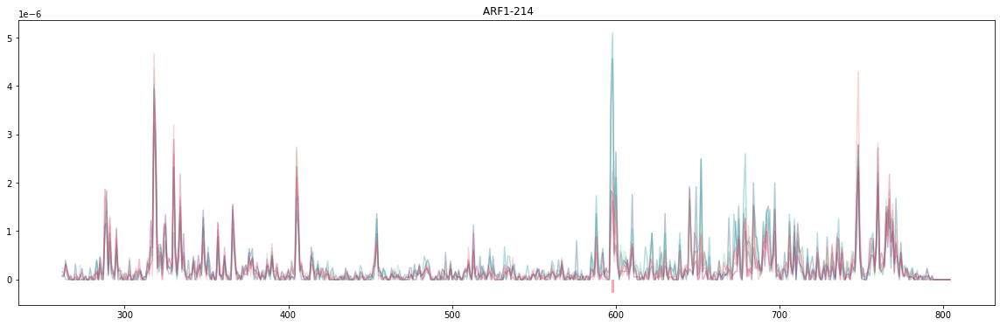

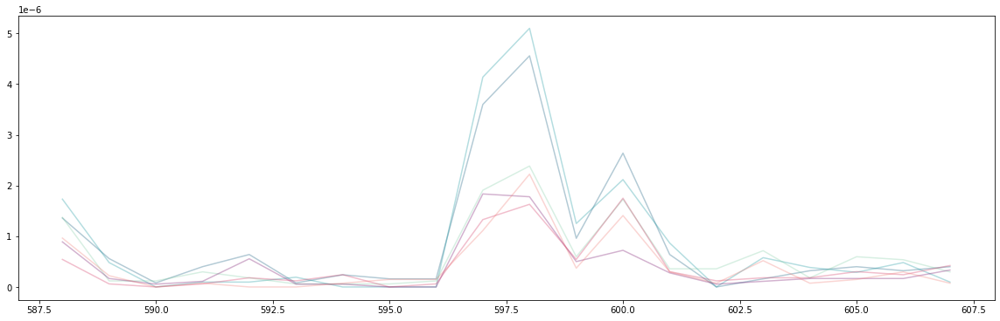

CTSL-203_848 logFC = -1.1626025729434364

TGGTTGGCTA C GGAT TTGAAAGCACAGAATCAGATAACAATAA ATATTGGCTGGTGAAG

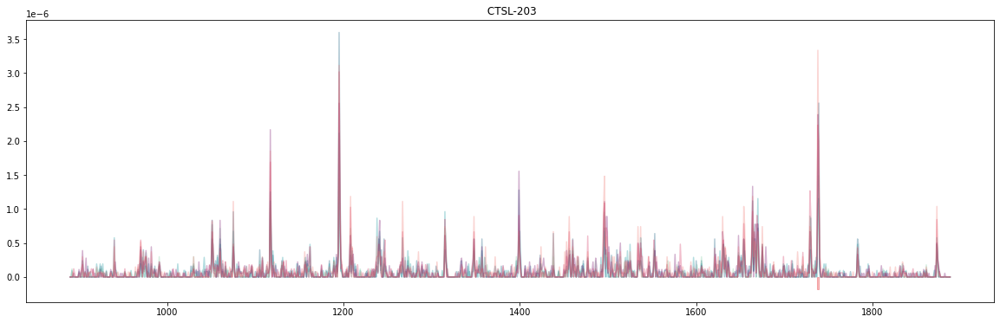

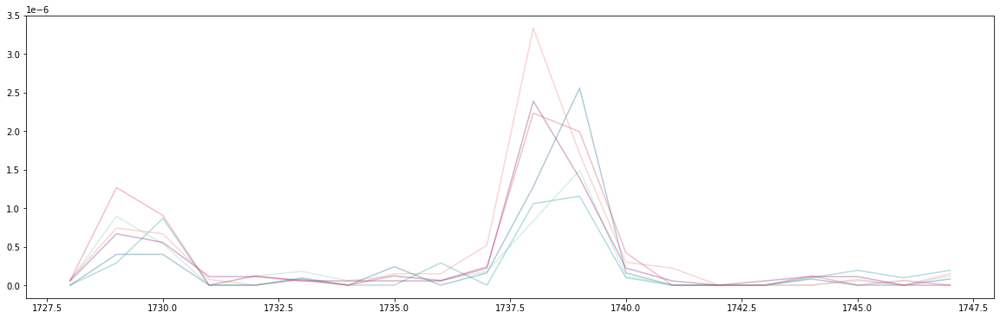

AHCYL1-202_1148 logFC = -1.1447318446734684

TGACACGGGA G CACT TGGATCGCATGAAAAACAGTTGTATCGT ATGCAATATGGGCCAC

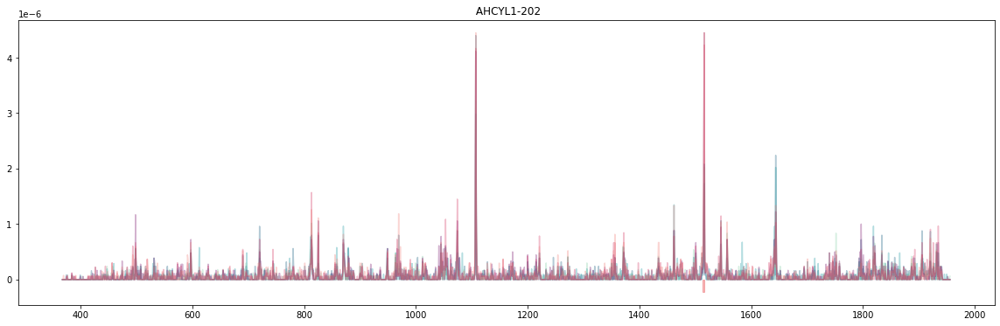

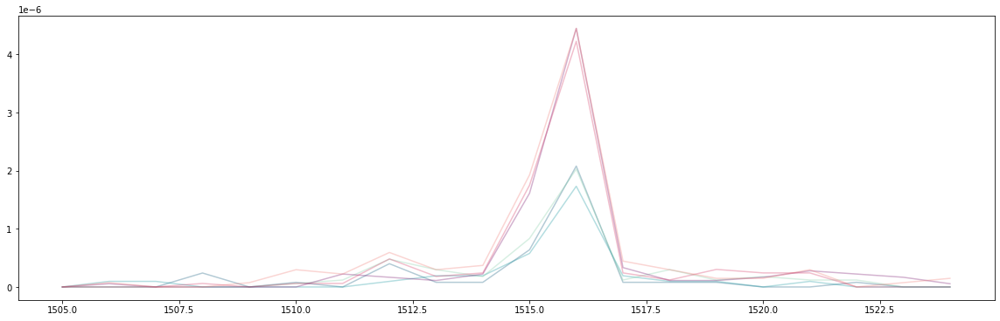

PRKDC-201_485 logFC = -1.0932354810113074

AACTTGCATT G AAAA AAAAAATACCAGATACAGTTTTAGAAAA AGTATATGAGCTCCTA

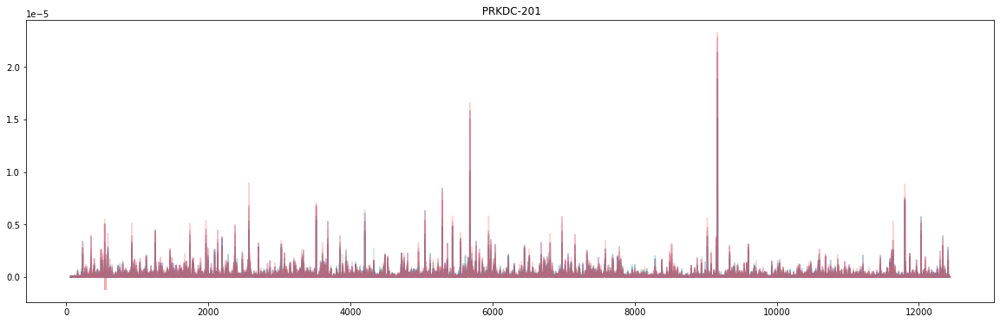

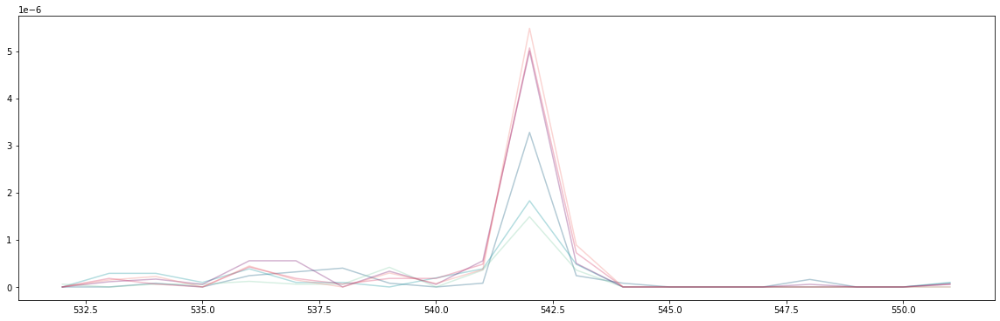

EIF3A-201_1019 logFC = -1.0397772177538263

ATATTGCTCG A CTTC TGGATATGGATGGCATTATAGTTGAAAA ACAGCGTCGCCTTGCA

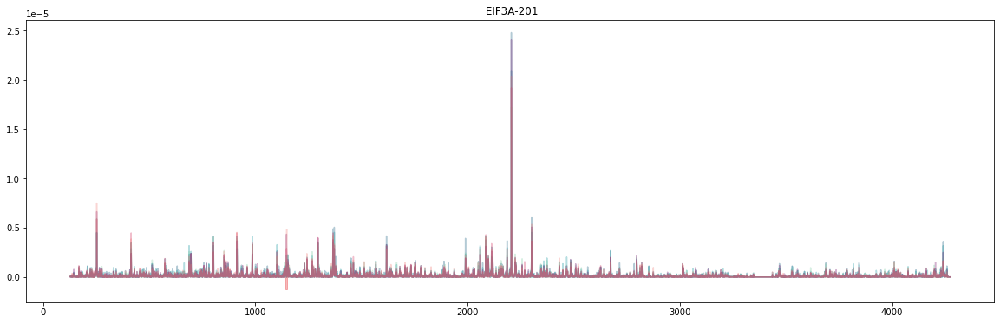

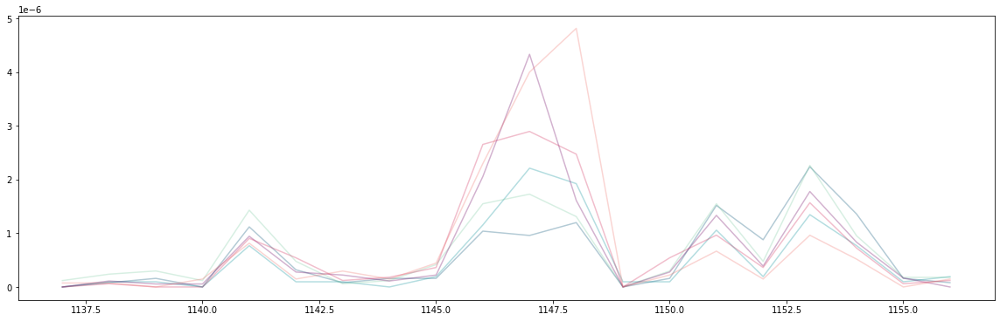

HDLBP-203_554 logFC = 1.025797483637725

CCAAAATCCA G ATCC CACGCCCAGATGACCCCAGCAATCAGAT CAAGATCACTGGCACC

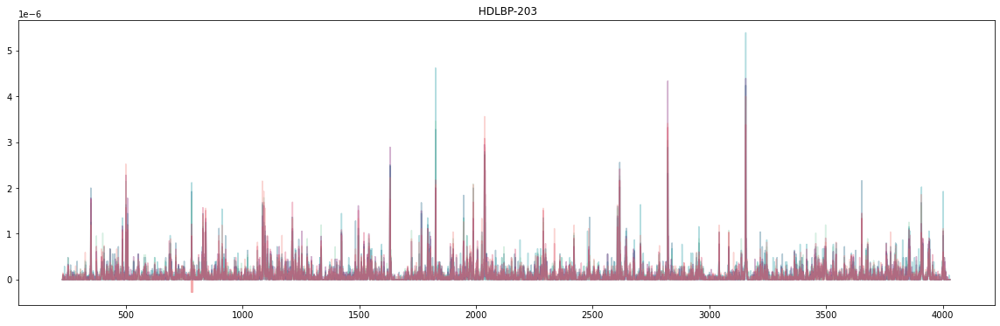

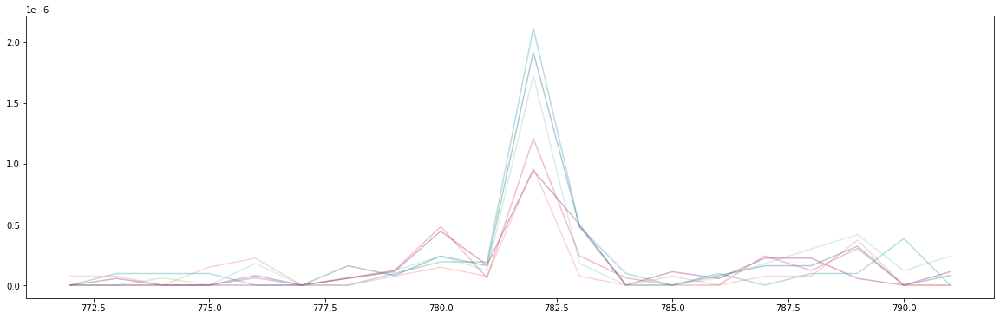

HDLBP-203_1599 logFC = 1.0091274912176555

CCGTGAAATT C GTGA CAAATTCCCAGAGGTCATCATTAACTTT CCAGACCCAGCACAAA

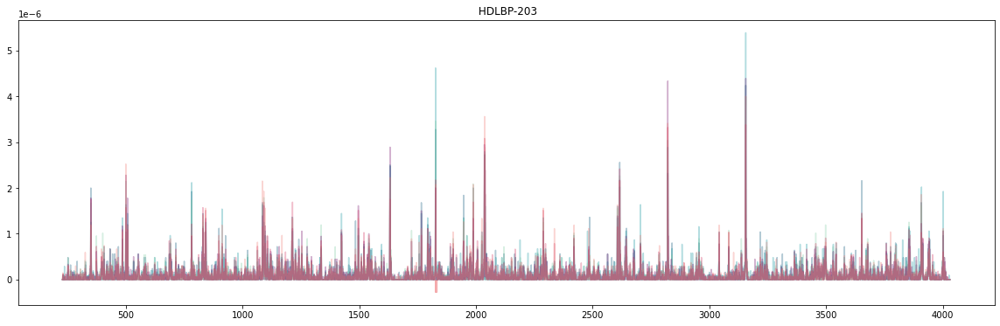

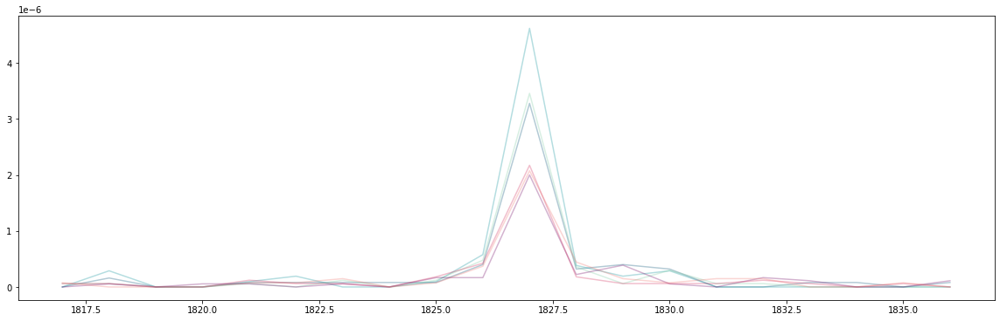

ILF3-219_1 logFC = -1.0025780006686946

T GCGT CCAATGCGAATTTTTGTGAATGATGACC GCCATGTGATGGCAAA

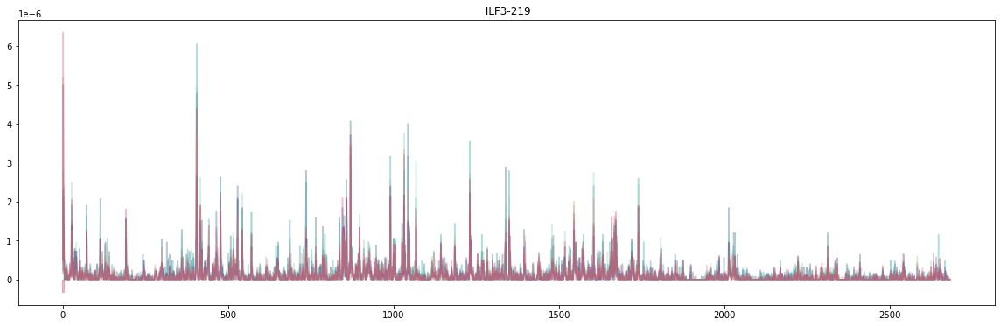

Couldn't plot this: x and y must have same first dimension, but have shapes (20,) and (0,)

PRMT5-202_567 logFC = 1.0023189085706814

GATGTGGTGG C ACAA CTTCCGGACTTTGTGTGACTATAGTAAG AGGATTGCAGTGGCTC

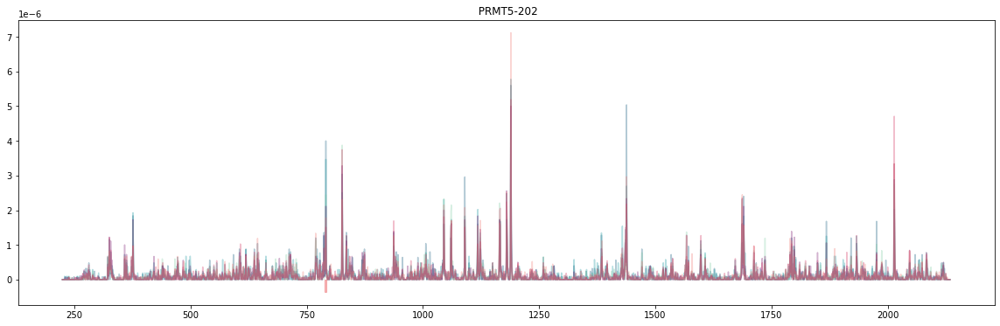

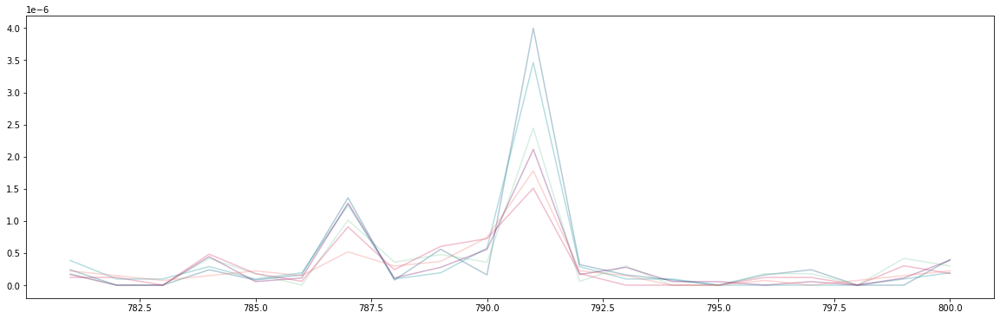

RPS3-217_80 logFC = -0.6124562373084318

TTCTTACTCG G GAGC TGGCTGAAGATGGCTACTCTGGAGTTGA GGTGCGAGTTACACCA

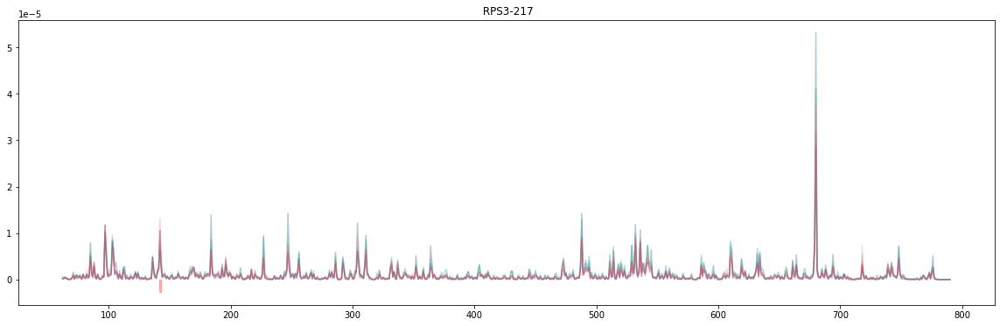

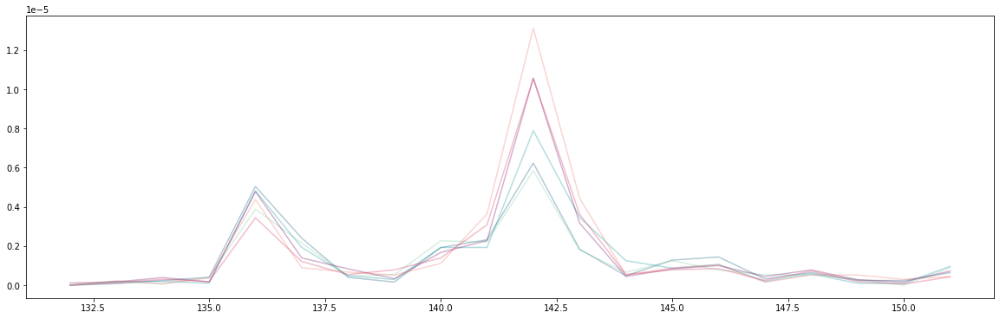

In [22]:
for s, logFC in level_2_sites:
    display_html("<center><b>{}</b><br>logFC = {}</center>".format(s, logFC), raw = True)
    #display_html("<center><b>{}</b></center>".format(s), raw = True)
    gene, position = s.split("_")
    position = int(position)
    adjusted_position  = adjust_position(position, gene, coverages)
    get_sequence( gene = gene, sequence_dict = gene_sequences, position = adjusted_position )
    
    try:
        plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = NSP_experiments,
                  gene_name   = gene , 
                  pause_site  = adjusted_position,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)
        plt.show()
    except Exception as this_exception:
        display_html("Couldn't plot this: {}".format(this_exception), raw = True)
    
    
    try: 
        plot_pause_site(\
                  coverages   = coverages,
                  experiments = NSP_experiments, 
                  pause_site  = adjusted_position,
                  gene_name   = gene,
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)
        plt.show()
    except Exception as this_exception:
        display_html("Couldn't plot this: {}".format(this_exception), raw = True)

## Pause Site Examples For the Manuscript

In [23]:
def plot_multiple_coverage(
                  coverages,
                  experiments,
                  gene_name, 
                  pause_site,
                  depth_dict  = None,
                  normalize   = False,
                  legend      = False,
                  alpha       = 1,
):
    """
    If you want to get the results normalized,
    provide a dictionary of experiment sizes
       experiment_name -> size
    """
    
    coverage_dict = coverages
    #experiments   = ['20200717-NSP1-HEK-1-setB', '20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB', '20200717-WT-HEK-1-setB']          
    #gene_name     = "EEF1A1-202" 
    norm_factors  = depth_dict
    bin_size       = 1
    title          = ""
    
    ymax   = 0
    #colors = ["blue", "red", "green", "orange", "black", "yellow", "brown", "pink", "cyan"]
    #if len(experiments) > len(colors):
    #    print("Maximum {} exepriments are allowed.".format( len(colors) ) )
    
    cds_start = coverage_dict[experiments[0]][0].loc[gene_name, "cds_start"]
    cds_stop  = coverage_dict[experiments[0]][0].loc[gene_name, "cds_stop"]
    x_range   = tuple(range(cds_start, cds_stop)) 
    
    plot_pause_sites = [pause_site]
    
    
    for i, e in enumerate(experiments):
        e_vector = coverage_dict[e][1][gene_name][cds_start:cds_stop]
        
        if normalize:
            e_vector = np.divide(e_vector, norm_factors[e]) * 1000000
            
        this_color = EXPERIMENT_COLORS[e]
        #ax.plot(e_vector, alpha = 0.2, color = colors[i])
        plt.plot(x_range, e_vector, alpha = alpha , color = this_color, linewidth = 3)
        ymax = max(ymax, max(e_vector))
        

    
    ymin = -1 * 0.05 * ymax 
    #plt.set_ylim([ymin, ymax])
    #plt.set_xlim([0, len(e_vector)])
    
    edge = 0.001 * (cds_stop - cds_start)
    
    for site in plot_pause_sites: 
        plt.fill_between(x     = (site - edge , site + edge), 
                         y1    = ymin, y2 = 0, 
                         color = "#e31a1d", alpha = 0.3)
    

    plt.title(title + " " + gene_name)
    plt.xlabel("Position")
    plt.ylabel("Reads Per Million")
    if legend: 
        plt.legend( tuple(map( lambda x: x[9:-5],experiments)), loc='upper right')

In [24]:
def plot_pause_site(
                  coverages,
                  experiments, 
                  pause_site,
                  gene_name,
                  radius      = 10, 
                  depth_dict  = None,
                  normalize   = False,
                  legend      = False,
                  alpha       = 1
):
    """
    If you want to get the results normalized,
    provide a dictionary of experiment sizes
       experiment_name -> size
    """
    
    coverage_dict = coverages
    #experiments   = ['20200717-NSP1-HEK-1-setB', '20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB', '20200717-WT-HEK-1-setB']          
    #gene_name     = "EEF1A1-202" 
    norm_factors  = depth_dict
    bin_size       = 1
    title          = ""
    

    #colors = ["blue", "red", "green", "orange", "black", "yellow", "brown", "pink", "cyan"]
    #if len(experiments) > len(colors):
    #    print("Maximum {} exepriments are allowed.".format( len(colors) ) )
    

    x_range   = tuple(range(pause_site - radius, pause_site + radius + 1))
    
    x_ticks   = ( pause_site - radius, pause_site - radius/2 , pause_site, pause_site + radius/2, pause_site + radius ) 
    x_ticks   = tuple( map(int, x_ticks) )
    plt.xticks(x_ticks, x_ticks)
    
    plt.xlabel("Position")
    plt.ylabel("Reads Per Million")
    plt.title("Pause Site of {}".format(gene_name))

    
    
    for i, e in enumerate(experiments):
        e_vector = coverage_dict[e][1][gene_name][pause_site - radius: pause_site + radius  + 1]
        
        if normalize:
            e_vector = np.divide(e_vector, norm_factors[e]) * 1000000
            
        this_color = EXPERIMENT_COLORS[e]
        #ax.plot(e_vector, alpha = 0.2, color = colors[i])
        plt.plot(x_range, e_vector, alpha = alpha , color = this_color, linewidth = 3)


In [25]:
this_pause_site = adjust_position(position = 230, gene = "COX7A2L-202", coverages = coverages)

plt.rcParams['figure.figsize'] = [20, 20]
plt.figure( 1, (20,20),dpi = FIGURE_RESOLUTION )

plt.subplot(2, 1, 1)
plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = ['20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB'],
                  gene_name   = "COX7A2L-202" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True,
                  alpha       = 1
)

#plt.show()

this_pause_site = adjust_position(position = 230, gene = "COX7A2L-202", coverages = coverages)

plt.subplot(2, 1, 2)
plot_pause_site(\
                  coverages  = coverages,
                  experiments = ['20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB'], 
                  pause_site = this_pause_site,
                  gene_name = "COX7A2L-202",
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)

#plt.show()

plt.savefig("COX7A2L_main.pdf")

In [26]:
this_pause_site = adjust_position(position = 230, gene = "COX7A2L-202", coverages = coverages)

plt.figure( 1, (20,20),dpi = FIGURE_RESOLUTION )

plt.subplot(2, 1, 1)

plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = NSP_experiments,
                  gene_name   = "COX7A2L-202" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True,
                  alpha       = 0.5
)



this_pause_site = adjust_position(position = 230, gene = "COX7A2L-202", coverages = coverages)

plt.subplot(2, 1, 2)
plot_pause_site(\
                  coverages  = coverages,
                  experiments = NSP_experiments, 
                  pause_site = this_pause_site,
                  gene_name = "COX7A2L-202",
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False,
                  alpha       = 0.5)

plt.savefig("COX7A2L_supp.pdf")

In [27]:
NSP_experiments

['20200717-NSP1-HEK-1-setB',
 '20200717-NSP1-HEK-2-setB',
 '20200717-NSP1-HEK-3-setB',
 '20200717-NSP2-HEK-1-setB',
 '20200717-NSP2-HEK-2-setB',
 '20200717-NSP2-HEK-3-setB']

### RPS3

In [28]:
this_pause_site = adjust_position(position = 80, gene = "RPS3-217", coverages = coverages)

plt.rcParams['figure.figsize'] = [20, 20]
plt.figure( 1, (20,20),dpi = FIGURE_RESOLUTION )

plt.subplot(2, 1, 1)
plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = ['20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB'],
                  gene_name   = "RPS3-217" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True,
                  alpha       = 1
)

#plt.show()

this_pause_site = adjust_position(position = 80, gene = "RPS3-217", coverages = coverages)

plt.subplot(2, 1, 2)
plot_pause_site(\
                  coverages  = coverages,
                  experiments = ['20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB'], 
                  pause_site = this_pause_site,
                  gene_name = "RPS3-217",
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)

#plt.show()

plt.savefig("RPS3_main.pdf")

In [29]:
this_pause_site = adjust_position(position = 80, gene = "RPS3-217", coverages = coverages)

plt.rcParams['figure.figsize'] = [20, 20]
plt.figure( 1, (20,20),dpi = FIGURE_RESOLUTION )

plt.subplot(2, 1, 1)
plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = NSP_experiments,
                  gene_name   = "RPS3-217" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True,
                  alpha       = 1
)

#plt.show()

this_pause_site = adjust_position(position = 80, gene = "RPS3-217", coverages = coverages)

plt.subplot(2, 1, 2)
plot_pause_site(\
                  coverages  = coverages,
                  experiments = NSP_experiments, 
                  pause_site = this_pause_site,
                  gene_name = "RPS3-217",
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)

#plt.show()

plt.savefig("RPS3_supp.pdf")

### ARF1

In [30]:
this_pause_site = adjust_position(position = 336, gene = "ARF1-214", coverages = coverages)

plt.rcParams['figure.figsize'] = [20, 20]
plt.figure( 1, (20,20),dpi = FIGURE_RESOLUTION )

plt.subplot(2, 1, 1)
plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = ['20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB'],
                  gene_name   = "ARF1-214" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True,
                  alpha       = 1
)

#plt.show()


plt.subplot(2, 1, 2)
plot_pause_site(\
                  coverages  = coverages,
                  experiments = ['20200717-NSP1-HEK-2-setB', '20200717-NSP2-HEK-2-setB'], 
                  pause_site = this_pause_site,
                  gene_name = "ARF1-214",
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)

#plt.show()

plt.savefig("ARF1_main.pdf")

In [31]:
this_pause_site = adjust_position(position = 336, gene = "ARF1-214", coverages = coverages)

plt.rcParams['figure.figsize'] = [20, 20]
plt.figure( 1, (20,20),dpi = FIGURE_RESOLUTION )

plt.subplot(2, 1, 1)
plot_multiple_coverage(
                  coverages   = coverages,
                  experiments = NSP_experiments,
                  gene_name   = "ARF1-214" , 
                  pause_site  = this_pause_site,
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = True,
                  alpha       = 1
)

#plt.show()


plt.subplot(2, 1, 2)
plot_pause_site(\
                  coverages  = coverages,
                  experiments = NSP_experiments, 
                  pause_site = this_pause_site,
                  gene_name = "ARF1-214",
                  radius      = 10, 
                  depth_dict  = depth_dict,
                  normalize   = True,
                  legend      = False)

#plt.show()

plt.savefig("ARF1_supp.pdf")